# Expression analysis for the RAGE pathway

## Preliminaries

In [1]:
import numpy as np
import pandas as pd
import scanpy as sc
import seaborn as sns
import os
import warnings
import scipy
import matplotlib.pyplot as plt
import scanpy.external as sce

In [2]:
data_folder = "../data"
result_folder = '../Result'
graph_folder = '../Graph'

In [3]:
sc.settings.verbosity = 4
sc.settings.set_figure_params(dpi=150, facecolor="white")
sc.logging.print_header()
sc.settings.figdir = graph_folder + '/'

scanpy==1.7.0 anndata==0.7.6 umap==0.4.6 numpy==1.18.5 scipy==1.6.1 pandas==1.2.2 scikit-learn==0.24.1 statsmodels==0.12.2 python-igraph==0.8.3 leidenalg==0.8.3


In [4]:
warnings.filterwarnings("ignore")

## Read input data

In [5]:
adata = sc.read(os.path.join(data_folder, "complete-gex-dataset-annotated.h5ad"))
adata

AnnData object with n_obs × n_vars = 143428 × 15935
    obs: 'n_genes', 'sample_tag', 'patient', 'time', 'lab_id', 'DOB', 'sex', 'ht', 'VES', 'PCR', 'FIBRINOGENO', 'ANTITROMB', 'sCD40L', 'EGF', 'Eotaxin', 'FGF-2', 'FLT-3L', 'Fractalkine', 'G-CSF', 'GM-CSF', 'GROalpha', 'IFNalpha2', 'IFNgamma', 'IL-1alpha', 'IL-1beta', 'IL-1RA', 'IL-2', 'IL-3', 'IL-4', 'IL-5', 'IL-6', 'IL-7', 'IL-8', 'IL-9', 'IL-10', 'IL-12p40', 'IL-12p70', 'IL-13', 'IL-15', 'IL-17A', 'IL-17E/IL-25', 'IL-17F', 'IL-18', 'IL-22', 'IL-27', 'IP-10', 'MCP-1', 'MCP-3', 'M-CSF', 'MDC', 'MIG', 'MIP-1alpha', 'MIP-1beta', 'PDGF-AA', 'PDGF-AB/BB', 'TGFalpha', 'TNFalpha', 'TNFbeta', 'VEGF-A', 'IgA', 'IgG', 'days_from_symptoms_to_admission', 'severity', 'age', 'alcohol', 'smoke', 'fever', 'cough', 'pneumo', 'oxygen', 'comorbities', 'hypertension', 'batch_id', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_rb', 'pct_counts_rb', 'total_counts_ab', 'pct_counts_ab', 'leiden', 'leiden_abseq_harmony

In [6]:
adata.X = adata.raw.X.copy()
sc.pp.normalize_total(adata, target_sum=1e4)

normalizing counts per cell
    finished (0:00:01)


In [7]:
adata.obs.head()

,n_genes,sample_tag,patient,time,lab_id,DOB,sex,ht,VES,PCR,...,leiden,leiden_abseq_harmony,leiden_abseq_harmony_new,cell_type,cell_families,age_bin,severity_code,sex_code,time_code,severity_coarse
756769-E_WTA,5881,E_WTA-SampleTag02_hs,P-19501,discharge,P0080,1972.0,M,12.0,45.0,61.0,...,14,25,25,B_Plasmacells,B_cells,40-50,1,1,2,mild
23221-E_WTA,5785,E_WTA-SampleTag02_hs,P-19501,discharge,P0080,1972.0,M,12.0,45.0,61.0,...,13,2,2_6,T_CD8-Proliferating,T_cells,40-50,1,1,2,mild
111423-E_WTA,5130,E_WTA-SampleTag02_hs,P-19501,discharge,P0080,1972.0,M,12.0,45.0,61.0,...,14,25,25,B_Plasmacells,B_cells,40-50,1,1,2,mild
359312-E_WTA,5211,E_WTA-SampleTag02_hs,P-19501,discharge,P0080,1972.0,M,12.0,45.0,61.0,...,14,25,25,B_Plasmacells,B_cells,40-50,1,1,2,mild
304475-E_WTA,4554,E_WTA-SampleTag02_hs,P-19501,discharge,P0080,1972.0,M,12.0,45.0,61.0,...,14,25,25,B_Plasmacells,B_cells,40-50,1,1,2,mild


In [8]:
adata.var.head()

,mt,rb,ab,n_cells_by_counts,mean_counts,pct_dropout_by_counts,total_counts,n_cells,highly_variable,means,dispersions,dispersions_norm
ab_CD103|ITGAE|AHS0001|pAbO,False,False,True,151824,5.293174,26.722686,1096698.0,151841,True,1.550142,4.343350,3.060377
ab_CD10|MME|AHS0051|pAbO,False,False,True,172324,8.685184,16.828434,1799492.0,172350,True,1.810511,3.098766,2.227114
ab_CD117:YB5.B8|KIT|AHS0064|pAbO,False,False,True,205268,57.611774,0.928129,11936641.0,205302,False,3.613691,4.897866,0.785726
ab_CD11b:ICRF44|ITGAM|AHS0184|pAbO,False,False,True,206576,435.780151,0.296828,90289728.0,206615,False,5.546603,6.228275,-0.678044
ab_CD11c:S-HCL-3|ITGAX|AHS0183|pAbO,False,False,True,206627,501.227112,0.272213,103849744.0,206665,False,5.652966,6.332122,-0.470417


In [9]:
adata.obs['severity_time'] = adata.obs['severity_coarse'].astype(str) + "_" + adata.obs['time'].astype(str)

In [10]:
adata.obs['patient_time'] = adata.obs['patient'].astype(str) + "_" + adata.obs['time'].astype(str)

In [11]:
adata.obs['mildness'] = adata.obs['severity_coarse'].map({'control': 'control', 'mild': 'mild', 'moderate': 'non-mild', 'sev+cri': 'non-mild'})

In [12]:
adata.obs['mildness_time'] = adata.obs['mildness'].astype(str) + "_" + adata.obs['time'].astype(str)

# Pathway score definition

In [13]:
"ACE2" in adata.var

False

**no expression of ACE2 in the dataset**

... storing 'severity_time' as categorical
... storing 'patient_time' as categorical
... storing 'mildness' as categorical
... storing 'mildness_time' as categorical


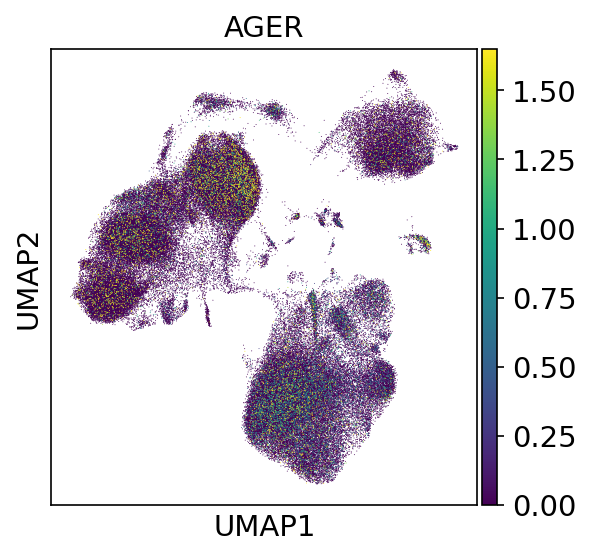

In [14]:
sc.pl.umap(adata, color=["AGER"], ncols=3, color_map="viridis", vmax="p98", vmin=0., use_raw=False)

In [15]:
rage_pathway_genes = ["FPR1", "HMGB1", "HMGB2", "S100A12", "S100A13", "S100A4", "S100A7", "S100A8", "S100A9", "S100B"]
rage_pathway_genes = ["FPR1", "HMGB1", "HMGB2", "S100A12", "S100A13", "S100A4", "S100A8", "S100A9", "S100B"]

the "S100A7" gene is removed from the list because it is absent from the dataset

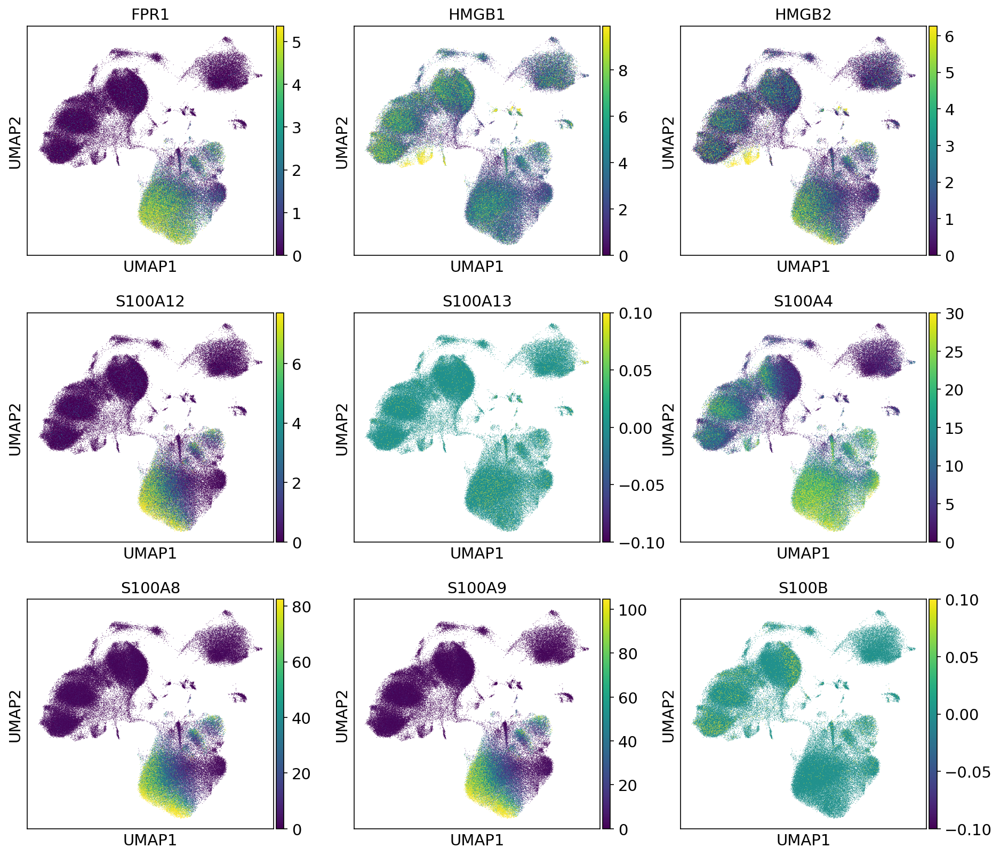

In [16]:
sc.pl.umap(adata, color=rage_pathway_genes, ncols=3, color_map="viridis", vmax="p98", vmin=0., use_raw=False)

define a new gene list that contains only the markers with moderate-to-high level of expression: the genes **'S100A13'** and **'S100B'** are excluded

In [17]:
rage_pathway_genes_red = ["FPR1", "HMGB1", "HMGB2", "S100A12", "S100A4", "S100A8", "S100A9"]

In [18]:
sc.tl.score_genes(adata, rage_pathway_genes_red, score_name="RAGE_ptw", use_raw=True)

computing score 'RAGE_ptw'
    finished: added
    'RAGE_ptw', score of gene set (adata.obs).
    50 total control genes are used. (0:00:03)


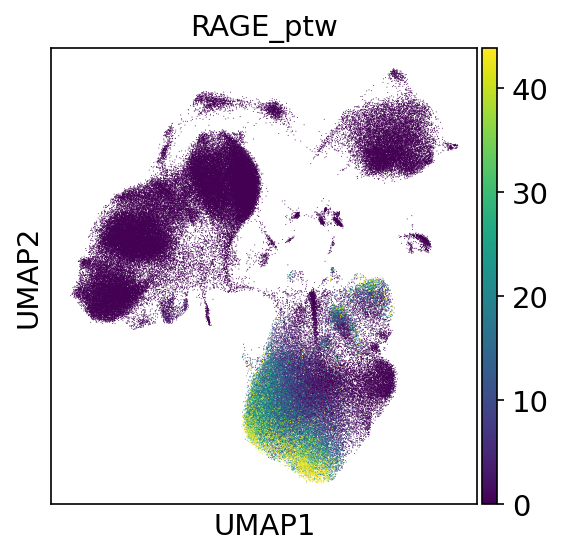

In [19]:
sc.pl.umap(adata, color=["RAGE_ptw"], ncols=3, color_map="viridis", vmax="p99", vmin=0., use_raw=False)

# Myeloid cells

## Restrict the dataset only to myeloid cells

**also remove Megakariyocytes / Mono P19131/ Mono-CD19+ / Mono p19312 / pDC**

In [20]:
adata_sub = adata[(adata.obs.cell_families == "Myeloid_cells") & 
            ~(adata.obs.cell_type.isin(['M_Megakaryocytes_And_pre-cDCs', 'M_Monocyte_P19131', 'M_Myeloid cells-CD19+', 'M_Myeloid-P19312', 'pDC']))]

In [21]:
sc.pp.neighbors(adata_sub, n_neighbors=20, n_pcs=40, use_rep="X_pca_harmony")

computing neighbors
        initialized `.distances` `.connectivities` 
    computing neighbors
    computed neighbors (0:00:23)
    computed connectivities (0:00:03)
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:28)


running Leiden clustering
    finished: found 15 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:25)
running PAGA
        initialized `.distances` `.connectivities` 
    finished: added
    'paga/connectivities', connectivities adjacency (adata.uns)
    'paga/connectivities_tree', connectivities subtree (adata.uns) (0:00:01)
--> added 'pos', the PAGA positions (adata.uns['paga'])


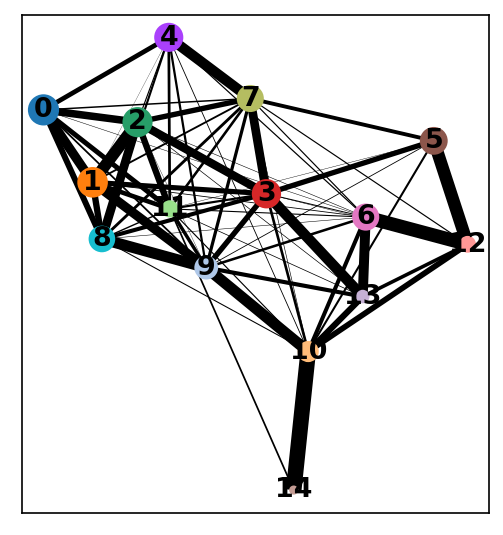

In [22]:
sc.tl.leiden(adata_sub)
sc.tl.paga(adata_sub)
sc.pl.paga(adata_sub)

In [23]:
sc.tl.umap(adata_sub, init_pos='paga')

computing UMAP


	completed  0  /  200 epochs
	completed  20  /  200 epochs
	completed  40  /  200 epochs
	completed  60  /  200 epochs
	completed  80  /  200 epochs
	completed  100  /  200 epochs
	completed  120  /  200 epochs
	completed  140  /  200 epochs
	completed  160  /  200 epochs
	completed  180  /  200 epochs


    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:34)


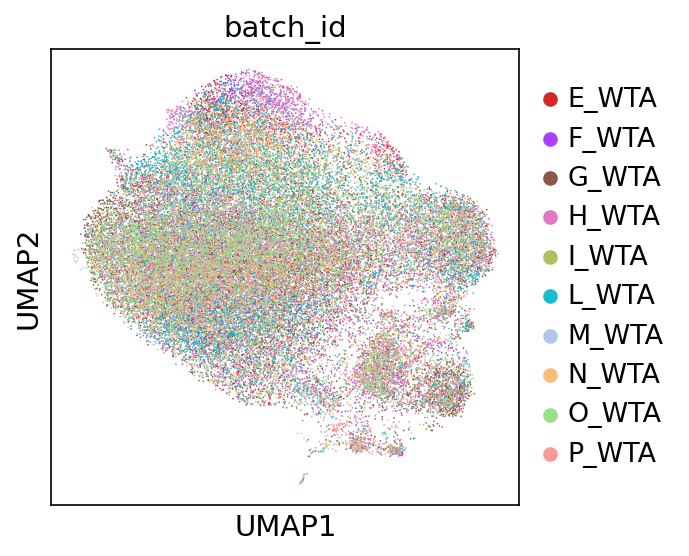

In [24]:
sc.pl.umap(adata_sub, color=['batch_id'])

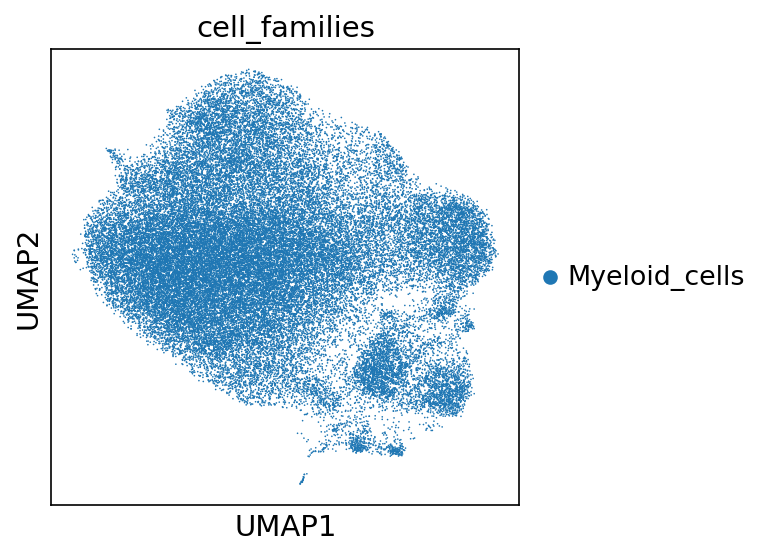

In [25]:
sc.pl.umap(adata_sub, color=['cell_families'], ncols=3, color_map="viridis", vmax="p98", vmin=0.)

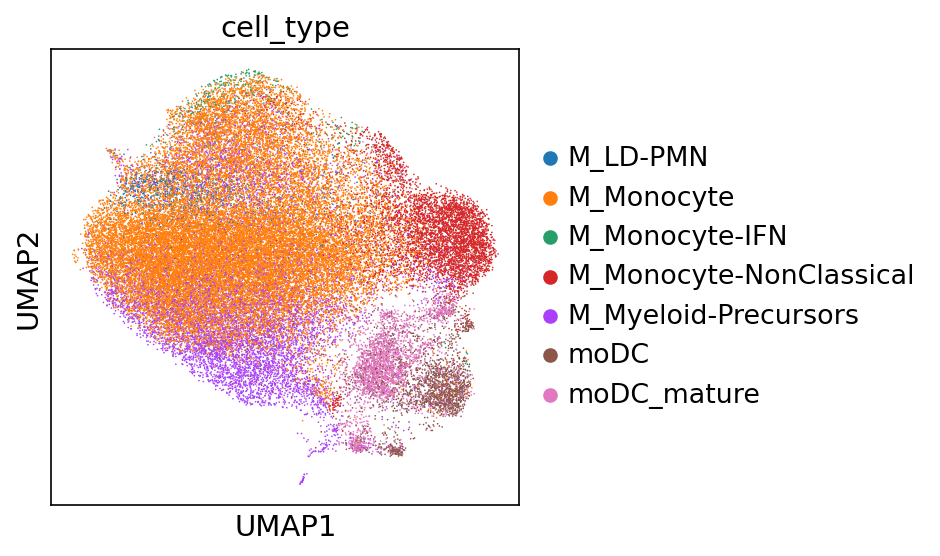

In [26]:
sc.pl.umap(adata_sub, color=['cell_type'], ncols=3, color_map="viridis", vmax="p98", vmin=0.)

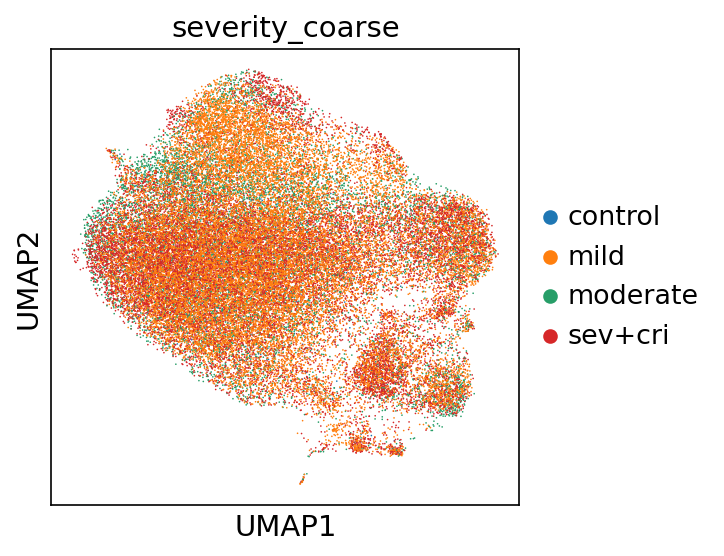

In [27]:
sc.pl.umap(adata_sub, color=['severity_coarse'], ncols=3, color_map="viridis", vmax="p98", vmin=0.)

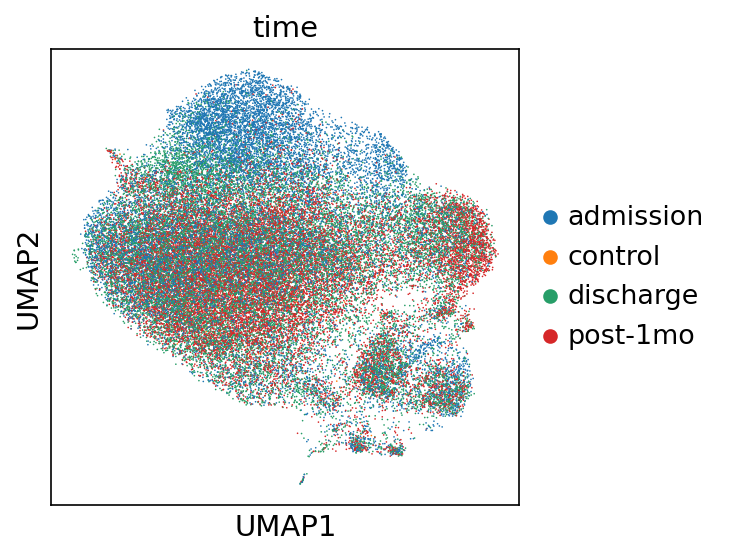

In [28]:
sc.pl.umap(adata_sub, color=['time'], ncols=3, color_map="viridis", vmax="p98", vmin=0.)

## Genes expression levels and pathway score

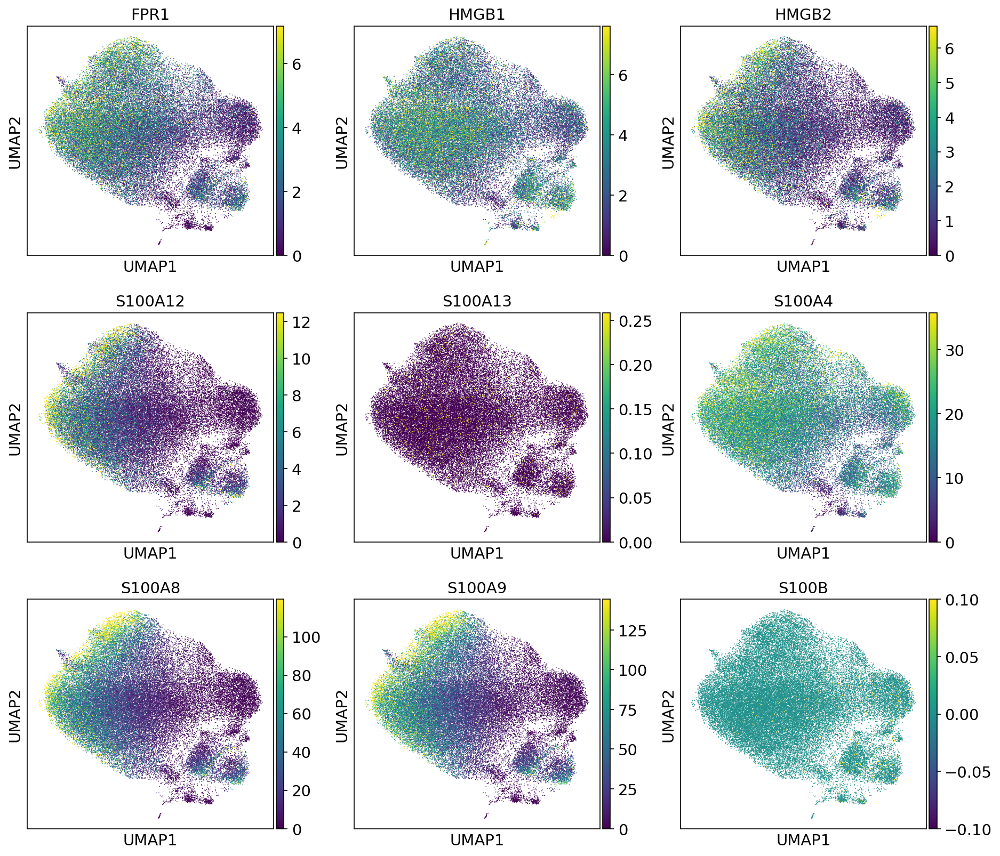

In [29]:
sc.pl.umap(adata_sub, color=rage_pathway_genes, ncols=3, color_map="viridis", vmax="p98", vmin=0., use_raw=False)

In [124]:
gene_values = pd.DataFrame(adata_sub[:, ['S100A8', 'S100A9']].X.todense())
gene_values.columns = ['S100A8', 'S100A9']
gene_values

,S100A8,S100A9
0,6.252791,5.359535
1,40.359352,42.493740
2,0.515207,0.171736
3,5.538542,12.380270
4,1.469508,1.102131
...,...,...
48534,0.000000,9.009008
48535,13.413815,13.413815
48536,97.216080,75.121521
48537,0.000000,2.385496


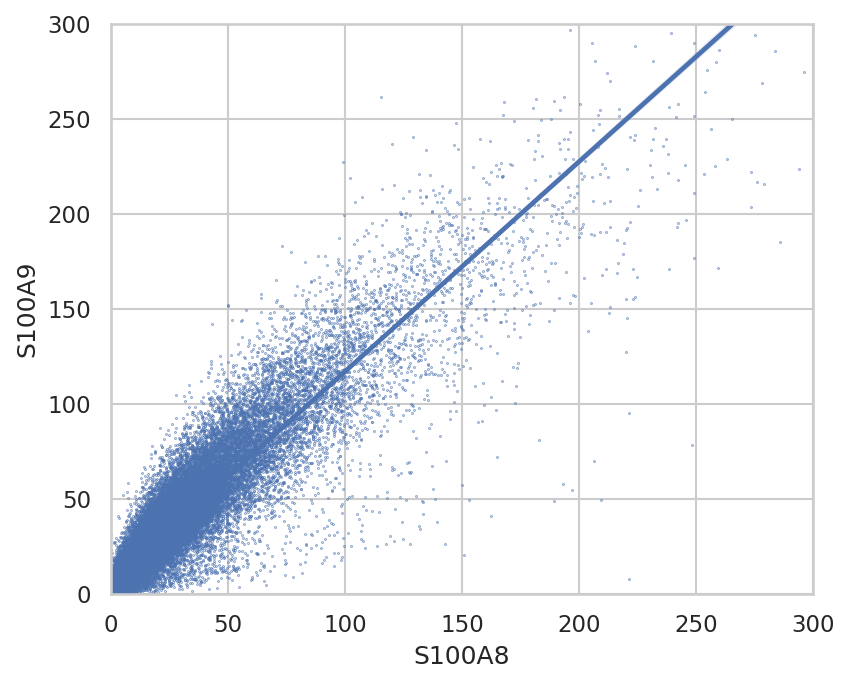

In [127]:
plt.figure(figsize=(6,5))
ax1 = plt.subplot(1,1,1)
sns.regplot(x="S100A8", y="S100A9", data=gene_values, ax=ax1, scatter_kws={"s": 0.1})
#sc.pl.scatter(adata_sub, x="S100A8", y="S100A9", use_raw=False, ax=ax1)
ax1.set_xlim([0,300])
ax1.set_ylim([0,300])
plt.show()

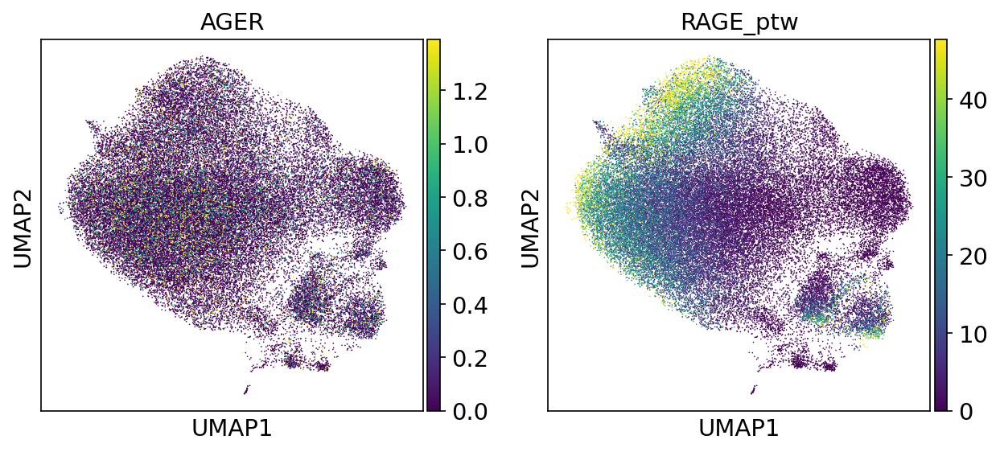

In [30]:
sc.pl.umap(adata_sub, color=["AGER", "RAGE_ptw"], ncols=3, color_map="viridis", vmax="p98", vmin=0., use_raw=False)

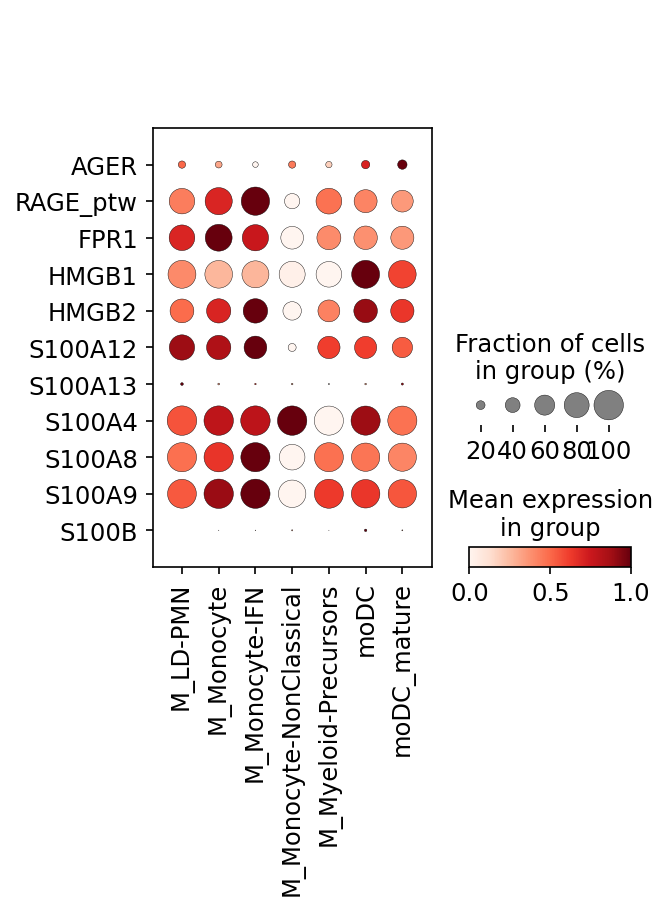

In [31]:
sc.pl.dotplot(adata_sub[(adata_sub.obs.time == "admission")],
              var_names=["AGER", "RAGE_ptw"] + rage_pathway_genes, groupby='cell_type', 
              use_raw=True, expression_cutoff=0, swap_axes=True, standard_scale="var")

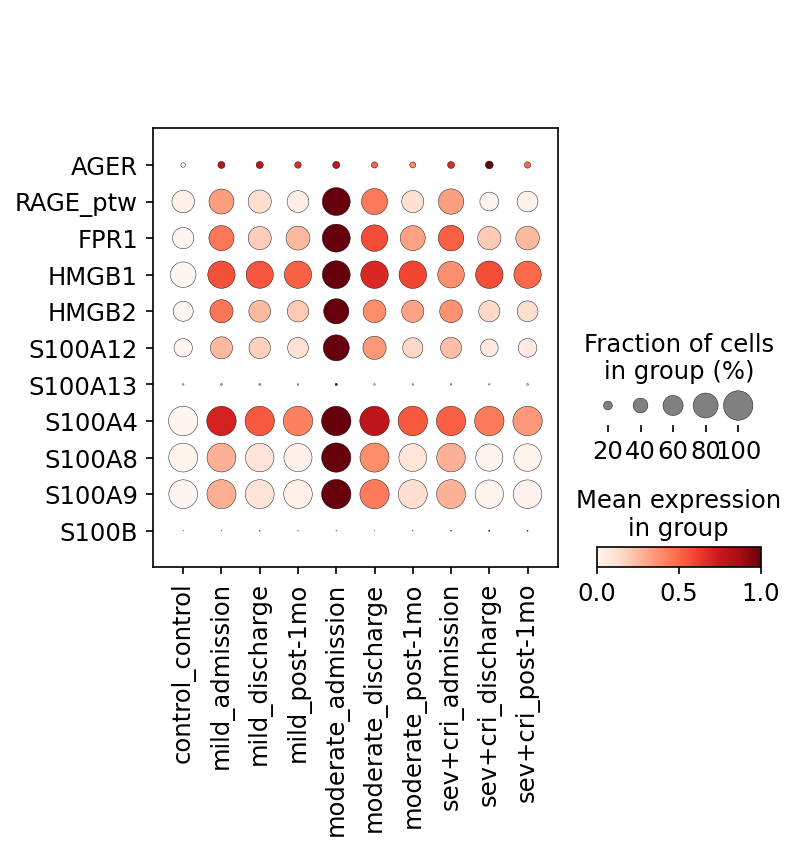

In [32]:
sc.pl.dotplot(adata_sub, var_names=["AGER", "RAGE_ptw"] + rage_pathway_genes,
              groupby='severity_time', use_raw=True, expression_cutoff=0, swap_axes=True, standard_scale="var")

## Dotplots grouped by patients-time for the different severities separately

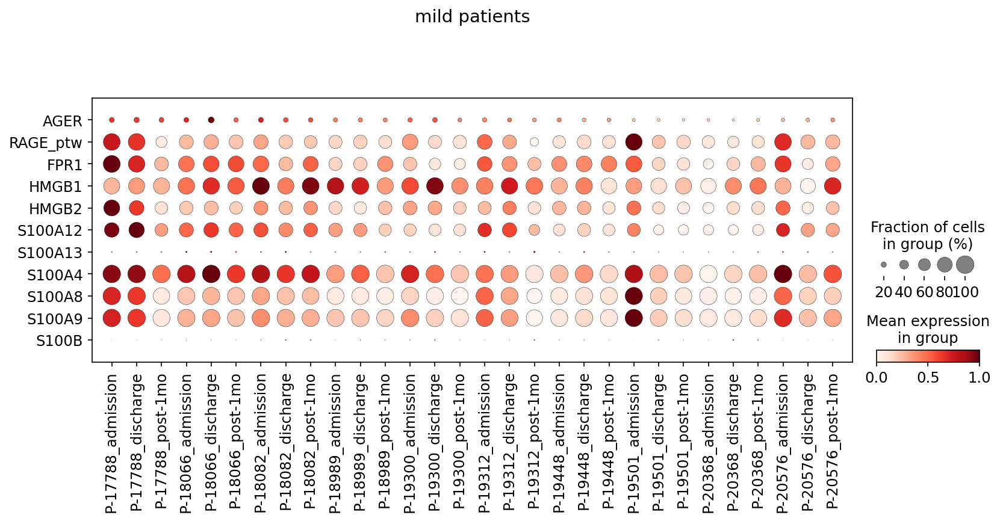

In [33]:
sc.pl.dotplot(adata_sub[(adata_sub.obs.severity_coarse == "mild")], title="mild patients",
              var_names=["AGER", "RAGE_ptw"] + rage_pathway_genes, groupby='patient_time', use_raw=True, 
              expression_cutoff=0, swap_axes=True, standard_scale="var")

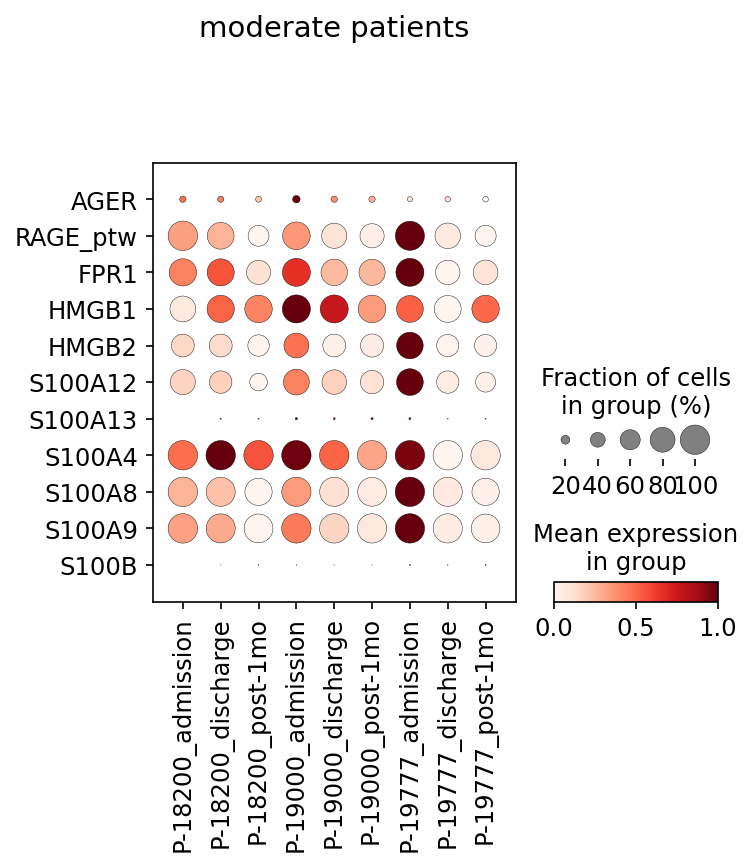

In [34]:
sc.pl.dotplot(adata_sub[(adata_sub.obs.severity_coarse == "moderate")], title="moderate patients",
              var_names=["AGER", "RAGE_ptw"] + rage_pathway_genes, groupby='patient_time', 
              use_raw=True, expression_cutoff=0, swap_axes=True, standard_scale="var")

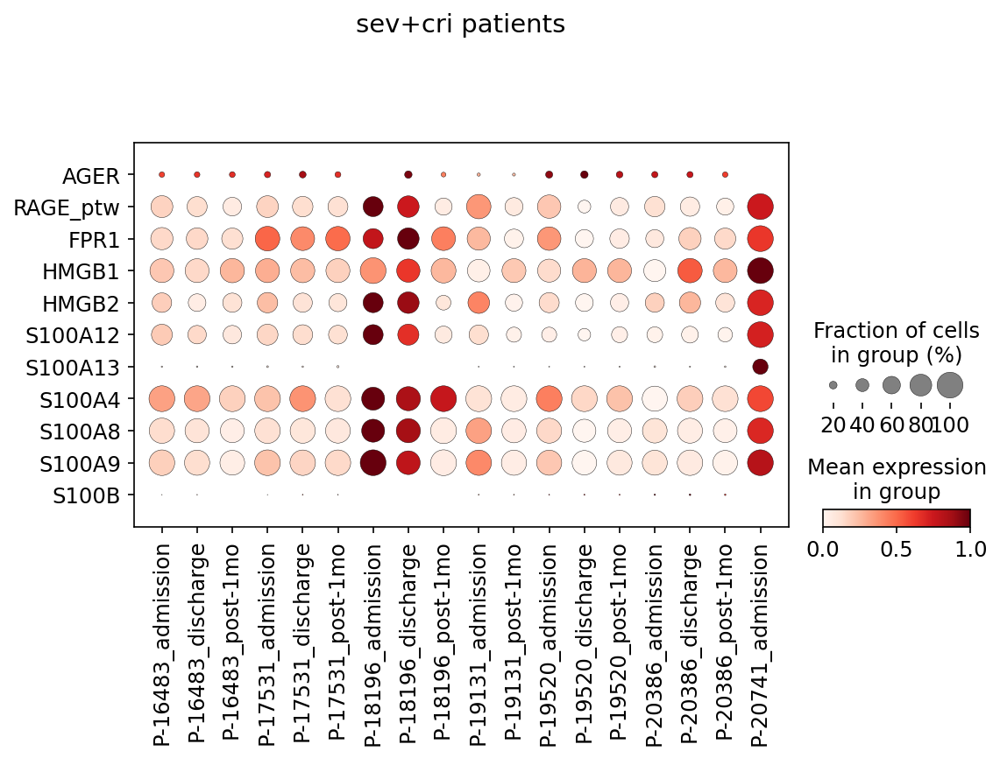

In [35]:
sc.pl.dotplot(adata_sub[(adata_sub.obs.severity_coarse == "sev+cri")], title="sev+cri patients",
              var_names=["AGER", "RAGE_ptw"] + rage_pathway_genes,
              groupby='patient_time', use_raw=True, expression_cutoff=0, swap_axes=True, standard_scale="var")

## Dotplots grouped by patients for the different time points separately

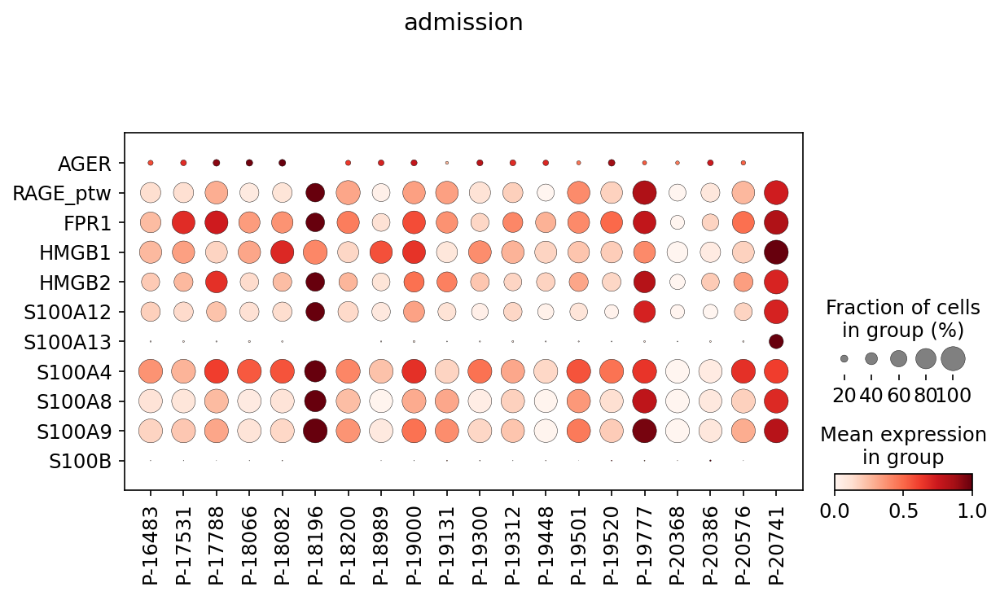

In [36]:
sc.pl.dotplot(adata_sub[(adata_sub.obs.time == "admission")], 
              var_names=["AGER", "RAGE_ptw"] + rage_pathway_genes, groupby='patient', 
              use_raw=True, expression_cutoff=0, swap_axes=True, standard_scale="var", title="admission")

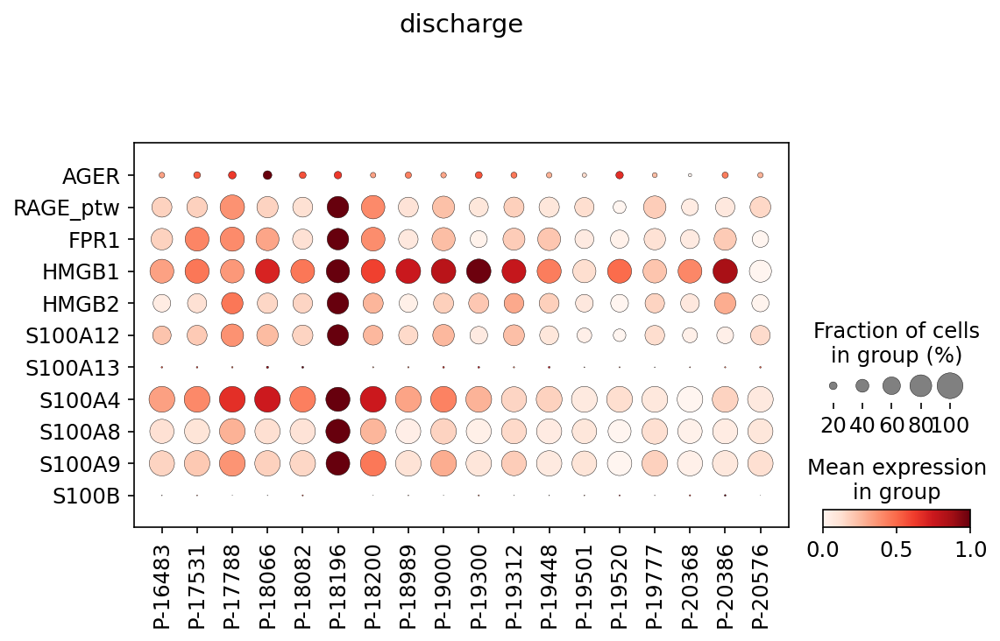

In [37]:
sc.pl.dotplot(adata_sub[(adata_sub.obs.time == "discharge")], var_names=["AGER", "RAGE_ptw"] + rage_pathway_genes,
              groupby='patient', use_raw=True, expression_cutoff=0, swap_axes=True, standard_scale="var", title="discharge")

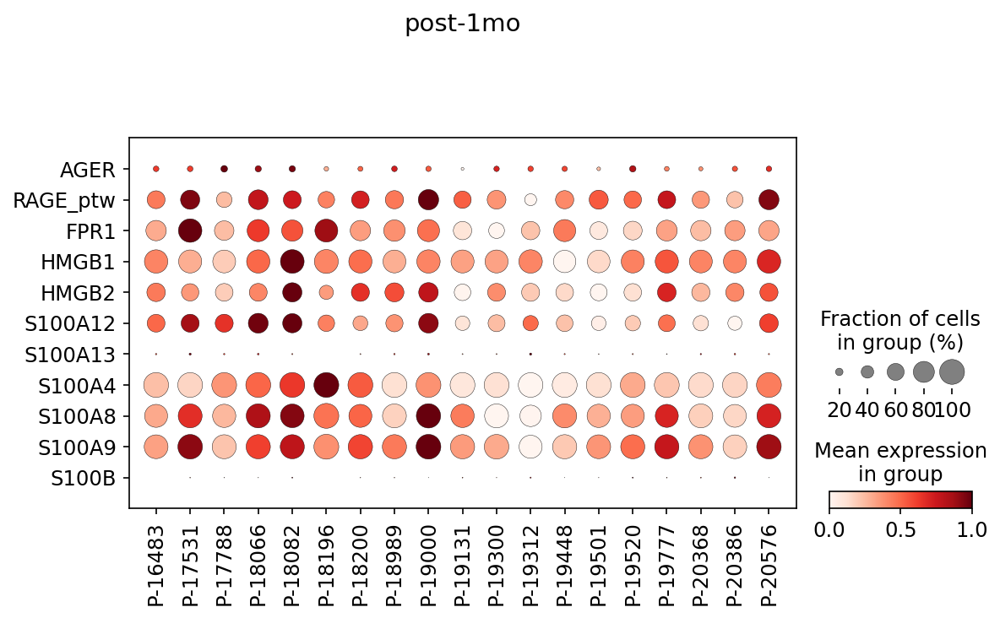

In [38]:
sc.pl.dotplot(adata_sub[(adata_sub.obs.time == "post-1mo")], var_names=["AGER", "RAGE_ptw"] + rage_pathway_genes,
              groupby='patient', use_raw=True, expression_cutoff=0, swap_axes=True, standard_scale="var", title="post-1mo")

## RAGE pathway average score

In [39]:
patient_metadata = ["severity_coarse", "patient", "time", "severity_time", "oxygen", "age", 'mildness_time', 'mildness']

In [40]:
patient_mean = adata_sub.obs[patient_metadata + ["RAGE_ptw"]].groupby(by=patient_metadata, observed=True, dropna=True).mean()
patient_mean.reset_index(inplace=True)

for i in patient_mean.columns:
    try:
        patient_mean[i] = patient_mean[i].cat.remove_unused_categories()
    except AttributeError:
        pass
    
patient_mean

,severity_coarse,patient,time,severity_time,oxygen,age,mildness_time,mildness,RAGE_ptw
0,sev+cri,P-19131,post-1mo,sev+cri_post-1mo,1.0,56.0,non-mild_post-1mo,non-mild,4.209863
1,sev+cri,P-19131,admission,sev+cri_admission,1.0,56.0,non-mild_admission,non-mild,21.531551
2,sev+cri,P-20386,post-1mo,sev+cri_post-1mo,1.0,56.0,non-mild_post-1mo,non-mild,2.154416
3,sev+cri,P-20386,admission,sev+cri_admission,1.0,56.0,non-mild_admission,non-mild,7.390679
4,sev+cri,P-20386,discharge,sev+cri_discharge,1.0,56.0,non-mild_discharge,non-mild,3.486052
5,sev+cri,P-19520,post-1mo,sev+cri_post-1mo,1.0,25.0,non-mild_post-1mo,non-mild,4.020101
6,sev+cri,P-19520,admission,sev+cri_admission,1.0,25.0,non-mild_admission,non-mild,12.531288
7,sev+cri,P-19520,discharge,sev+cri_discharge,1.0,25.0,non-mild_discharge,non-mild,0.102817
8,sev+cri,P-17531,post-1mo,sev+cri_post-1mo,1.0,67.0,non-mild_post-1mo,non-mild,7.088964
9,sev+cri,P-17531,admission,sev+cri_admission,1.0,67.0,non-mild_admission,non-mild,9.986671


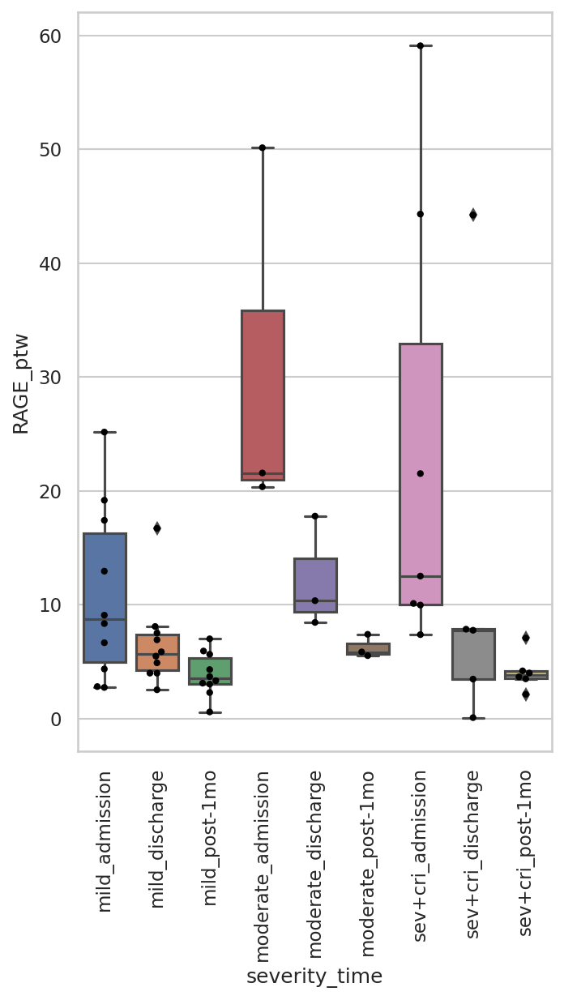

In [41]:
sns.set(rc={'figure.figsize':(5, 8)})
sns.set_style("whitegrid")
ax = sns.boxplot(y="RAGE_ptw", x="severity_time", data=patient_mean)
ax2 = sns.swarmplot(y="RAGE_ptw", x="severity_time", data=patient_mean, size=4, color="black")
lab = ax.set_xticklabels(ax.get_xticklabels(), rotation=90)

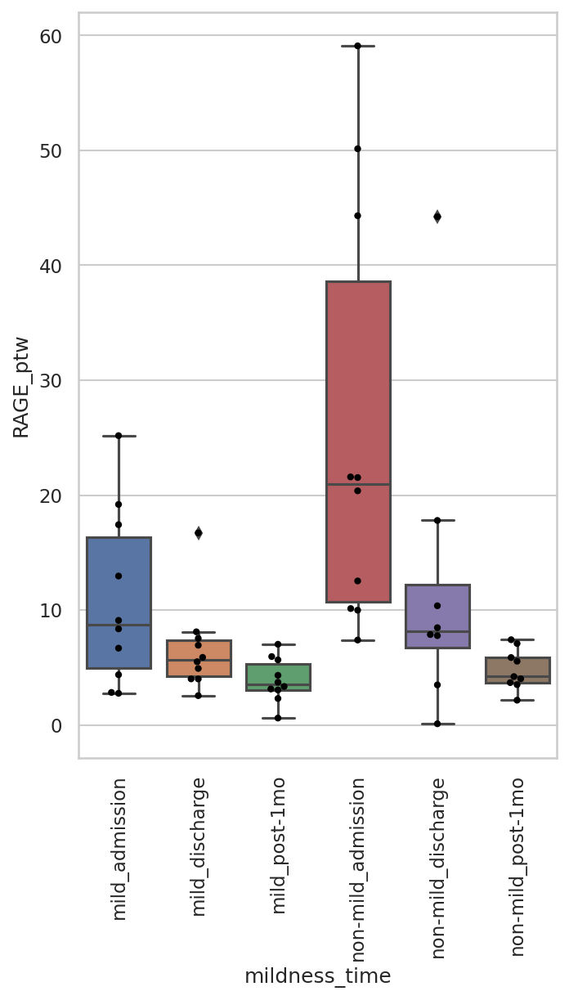

In [42]:
sns.set(rc={'figure.figsize':(5, 8)})
sns.set_style("whitegrid")
ax = sns.boxplot(y="RAGE_ptw", x="mildness_time", data=patient_mean)
ax2 = sns.swarmplot(y="RAGE_ptw", x="mildness_time", data=patient_mean, size=4, color="black")
lab = ax.set_xticklabels(ax.get_xticklabels(), rotation=90)

## Admission vs Discharge

| patients             | wilcoxon p-value   |  t-test p-value  |
| :-                   | :-                 |  :-              |
| **ALL**              | 0.0001258          | 0.004434757527604796   |
| **MILD**             | 0.0322265          | 0.03396817178333288    |
| **MODERATE+SEV+CRI** | 0.0039062          | 0.025507208787019016             |
| **SEV+CRI**          | 0.03125            | 0.026031765325707987   |

In [43]:
x = patient_mean[patient_mean.time == "admission"].set_index("patient").drop(["P-19131", "P-20741"], errors="ignore")["RAGE_ptw"]
y = patient_mean[patient_mean.time == "discharge"].set_index("patient").drop(["P-19131", "P-20741"], errors="ignore")["RAGE_ptw"]
scipy.stats.wilcoxon(y, x,  alternative='less', mode='exact')

WilcoxonResult(statistic=9.0, pvalue=0.000125885009765625)

In [44]:
scipy.stats.ttest_rel(y, x, alternative='less')

Ttest_relResult(statistic=-3.0456723330699265, pvalue=0.003653242887449305)

In [45]:
x = patient_mean[patient_mean.severity_time == "mild_admission"].set_index("patient")["RAGE_ptw"]
y = patient_mean[patient_mean.severity_time == "mild_discharge"].set_index("patient")["RAGE_ptw"]
scipy.stats.wilcoxon(y, x,  alternative='less', mode='exact')

WilcoxonResult(statistic=9.0, pvalue=0.0322265625)

In [46]:
scipy.stats.ttest_rel(y, x, alternative='less')

Ttest_relResult(statistic=-2.116283995678056, pvalue=0.03170962833127912)

In [47]:
x = patient_mean[(patient_mean.time == "admission") & (patient_mean.severity_coarse.isin(["sev+cri", "moderate"]))].set_index("patient").drop(["P-19131", "P-20741"], errors="ignore")["RAGE_ptw"]
y = patient_mean[(patient_mean.time == "discharge") & (patient_mean.severity_coarse.isin(["sev+cri", "moderate"]))].set_index("patient").drop(["P-19131", "P-20741"], errors="ignore")["RAGE_ptw"]
scipy.stats.wilcoxon(y, x,  alternative='less', mode='exact')

WilcoxonResult(statistic=0.0, pvalue=0.00390625)

In [48]:
scipy.stats.ttest_rel(y, x, alternative='less')

Ttest_relResult(statistic=-2.4289869266816195, pvalue=0.022744062742016034)

In [49]:
x = patient_mean[(patient_mean.time == "admission") & (patient_mean.severity_coarse.isin(["sev+cri"]))].set_index("patient").drop(["P-19131", "P-20741"], errors="ignore")["RAGE_ptw"]
y = patient_mean[(patient_mean.time == "discharge") & (patient_mean.severity_coarse.isin(["sev+cri"]))].set_index("patient").drop(["P-19131", "P-20741"], errors="ignore")["RAGE_ptw"]
scipy.stats.wilcoxon(y, x,  alternative='less', mode='exact')

WilcoxonResult(statistic=0.0, pvalue=0.03125)

In [50]:
scipy.stats.ttest_rel(y, x, alternative='less')

Ttest_relResult(statistic=-2.638191909607234, pvalue=0.028844687271926198)

## Admission vs Post-1mo

| patients             | wilcoxon p-value       |  t-test p-value |
| :-                   | :-                     | :-   |
| **ALL**              | 3.814697265625e-05     | 0.0020346353141977302 |
| **MILD**             | 0.009765625            | 0.01111573252258278 |
| **MODERATE+SEV+CRI** | 0.00390625             | 0.01602916629426879 |
| **SEV+CRI**          | 0.03125                | 0.10072794598736227 |

In [51]:
x = patient_mean[patient_mean.time == "admission"].set_index("patient").drop(["P-19131", "P-20741"], errors="ignore")["RAGE_ptw"]
y = patient_mean[patient_mean.time == "post-1mo"].set_index("patient").drop(["P-19131", "P-20741"], errors="ignore")["RAGE_ptw"]
scipy.stats.wilcoxon(y, x,  alternative='less', mode='exact')

WilcoxonResult(statistic=3.0, pvalue=1.9073486328125e-05)

In [52]:
scipy.stats.ttest_rel(y, x, alternative='less')

Ttest_relResult(statistic=-3.443188548679676, pvalue=0.001551780337770387)

In [53]:
x = patient_mean[patient_mean.severity_time == "mild_admission"].set_index("patient")["RAGE_ptw"]
y = patient_mean[patient_mean.severity_time == "mild_post-1mo"].set_index("patient")["RAGE_ptw"]
scipy.stats.wilcoxon(y, x,  alternative='less', mode='exact')

WilcoxonResult(statistic=3.0, pvalue=0.0048828125)

In [54]:
scipy.stats.ttest_rel(y, x, alternative='less')

Ttest_relResult(statistic=-2.8505585598514847, pvalue=0.009535901174951025)

In [55]:
x = patient_mean[(patient_mean.time == "admission") & (patient_mean.severity_coarse.isin(["sev+cri", "moderate"]))].set_index("patient").drop(["P-19131", "P-20741"], errors="ignore")["RAGE_ptw"]
y = patient_mean[(patient_mean.time == "post-1mo") & (patient_mean.severity_coarse.isin(["sev+cri", "moderate"]))].set_index("patient").drop(["P-19131", "P-20741"], errors="ignore")["RAGE_ptw"]
scipy.stats.wilcoxon(y, x,  alternative='less', mode='exact')

WilcoxonResult(statistic=0.0, pvalue=0.00390625)

In [56]:
scipy.stats.ttest_rel(y, x, alternative='less')

Ttest_relResult(statistic=-2.717986048733439, pvalue=0.014926180723244087)

In [57]:
x = patient_mean[(patient_mean.time == "admission") & (patient_mean.severity_coarse.isin(["sev+cri"]))].set_index("patient").drop(["P-19131", "P-20741"], errors="ignore")["RAGE_ptw"]
y = patient_mean[(patient_mean.time == "post-1mo") & (patient_mean.severity_coarse.isin(["sev+cri"]))].set_index("patient").drop(["P-19131", "P-20741"], errors="ignore")["RAGE_ptw"]
scipy.stats.wilcoxon(y, x,  alternative='less', mode='exact')

WilcoxonResult(statistic=0.0, pvalue=0.03125)

In [58]:
scipy.stats.ttest_rel(y, x, alternative='less')

Ttest_relResult(statistic=-1.5728688448223611, pvalue=0.09542777957826504)

## Comparison of RAGE_ptw score between mild and severe+critical patients

In [59]:
patient_severity = patient_mean[["patient", "severity_coarse"]].drop_duplicates().sort_values(by="patient").set_index("patient")
patient_severity

,severity_coarse
patient,
P-16483,sev+cri
P-17531,sev+cri
P-17788,mild
P-18066,mild
P-18082,mild
P-18196,sev+cri
P-18200,moderate
P-18989,mild
P-19000,moderate


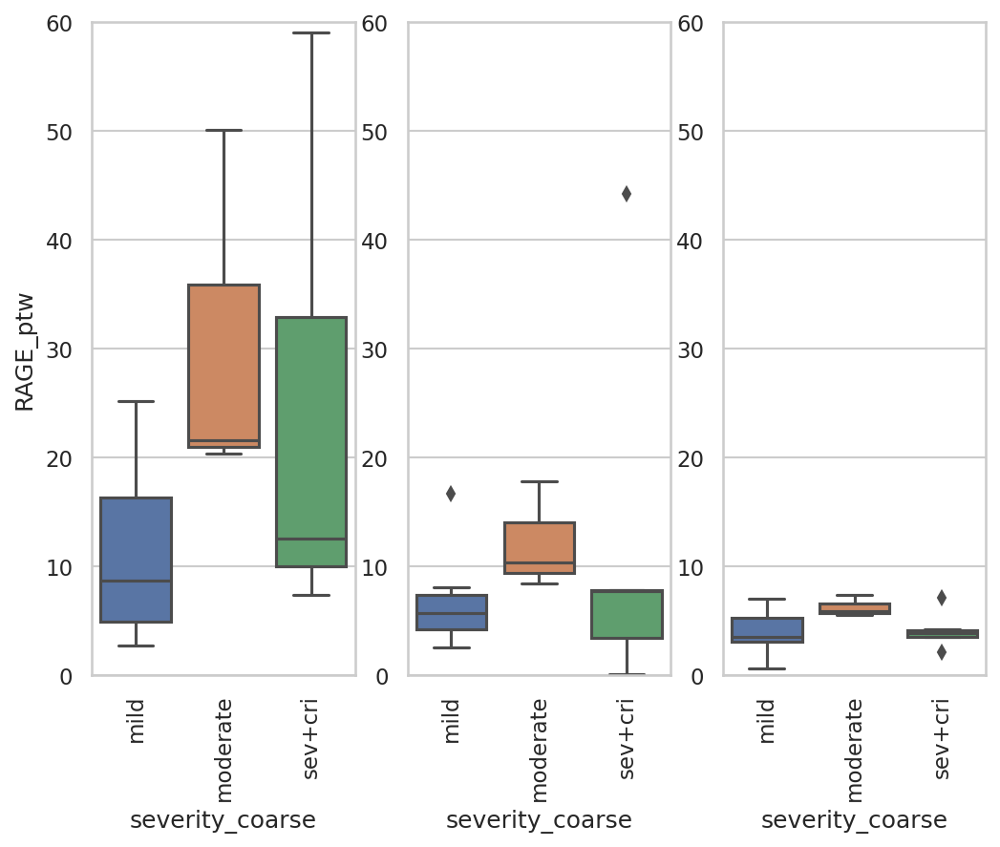

In [60]:
plt.figure(figsize=(8, 6))

sns.set(rc={'figure.figsize':(5, 8)})
sns.set_style("whitegrid")

plt.subplot("131")
ax = sns.boxplot(y="RAGE_ptw", x="severity_coarse", data=patient_mean[patient_mean.time == "admission"])
ax.set(ylim=(0, 60))
lab = ax.set_xticklabels(ax.get_xticklabels(), rotation=90)

plt.subplot("132")
ax = sns.boxplot(y="RAGE_ptw", x="severity_coarse", data=patient_mean[patient_mean.time == "discharge"])
ax.set(ylim=(0, 60))
lab = ax.set_xticklabels(ax.get_xticklabels(), rotation=90)
lab = ax.set_ylabel("")

plt.subplot("133")
ax = sns.boxplot(y="RAGE_ptw", x="severity_coarse", data=patient_mean[patient_mean.time == "post-1mo"])
ax.set(ylim=(0, 60))
lab = ax.set_xticklabels(ax.get_xticklabels(), rotation=90)
lab = ax.set_ylabel("")

In [61]:
x = patient_mean[(patient_mean.time == "admission") & (patient_mean.severity_coarse == "mild")]["RAGE_ptw"]
y = patient_mean[(patient_mean.time == "admission") & (patient_mean.severity_coarse == "sev+cri")]["RAGE_ptw"]
scipy.stats.mannwhitneyu(x, y, alternative='two-sided')

MannwhitneyuResult(statistic=19.0, pvalue=0.13036982841080633)

In [62]:
x = patient_mean[(patient_mean.time == "discharge") & (patient_mean.severity_coarse == "mild")]["RAGE_ptw"]
y = patient_mean[(patient_mean.time == "discharge") & (patient_mean.severity_coarse == "sev+cri")]["RAGE_ptw"]
scipy.stats.mannwhitneyu(x, y, alternative='two-sided')

MannwhitneyuResult(statistic=23.0, pvalue=0.8542396057680933)

In [63]:
x = patient_mean[(patient_mean.time == "post-1mo") & (patient_mean.severity_coarse == "mild")]["RAGE_ptw"]
y = patient_mean[(patient_mean.time == "post-1mo") & (patient_mean.severity_coarse == "sev+cri")]["RAGE_ptw"]
scipy.stats.mannwhitneyu(x, y, alternative='two-sided')

MannwhitneyuResult(statistic=27.0, pvalue=0.7862656133328394)

## Comparison of RAGE_ptw score between mild and non-mild patients

In [64]:
patient_mildness = patient_mean[["patient", "mildness"]].drop_duplicates().sort_values(by="patient").set_index("patient")
patient_mildness

,mildness
patient,
P-16483,non-mild
P-17531,non-mild
P-17788,mild
P-18066,mild
P-18082,mild
P-18196,non-mild
P-18200,non-mild
P-18989,mild
P-19000,non-mild


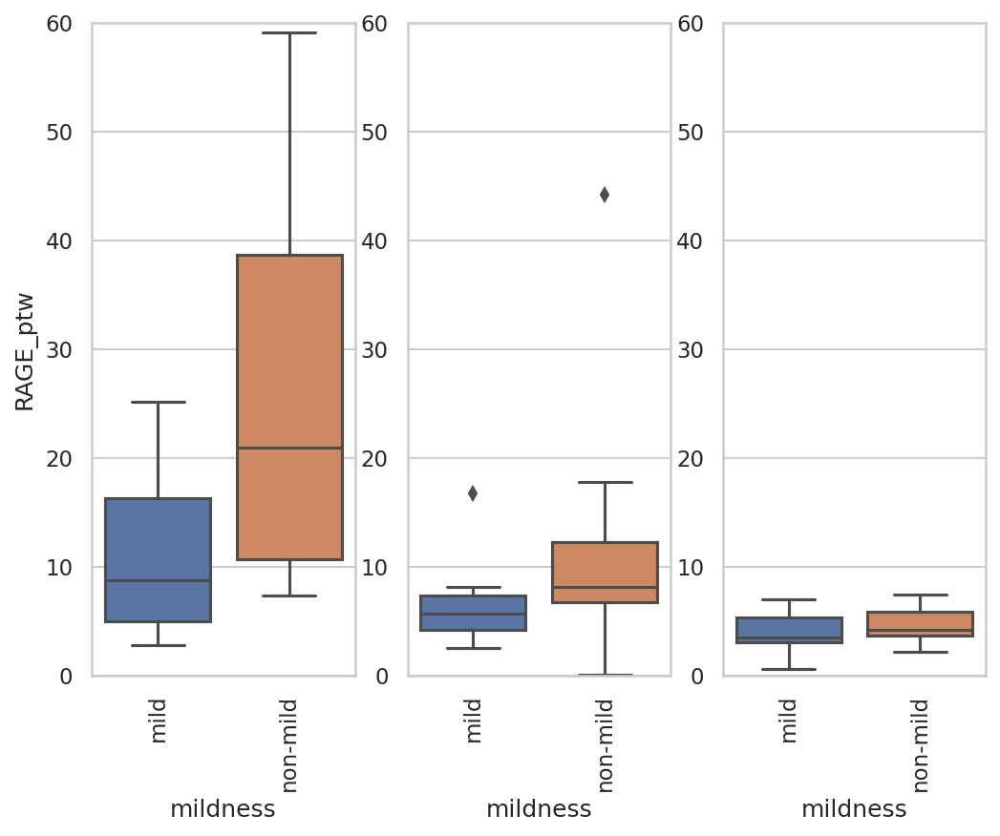

In [65]:
plt.figure(figsize=(8, 6))

sns.set(rc={'figure.figsize':(5, 8)})
sns.set_style("whitegrid")

plt.subplot("131")
ax = sns.boxplot(y="RAGE_ptw", x="mildness", data=patient_mean[patient_mean.time == "admission"])
ax.set(ylim=(0, 60))
lab = ax.set_xticklabels(ax.get_xticklabels(), rotation=90)

plt.subplot("132")
ax = sns.boxplot(y="RAGE_ptw", x="mildness", data=patient_mean[patient_mean.time == "discharge"])
ax.set(ylim=(0, 60))
lab = ax.set_xticklabels(ax.get_xticklabels(), rotation=90)
lab = ax.set_ylabel("")

plt.subplot("133")
ax = sns.boxplot(y="RAGE_ptw", x="mildness", data=patient_mean[patient_mean.time == "post-1mo"])
ax.set(ylim=(0, 60))
lab = ax.set_xticklabels(ax.get_xticklabels(), rotation=90)
lab = ax.set_ylabel("")

In [66]:
x = patient_mean[(patient_mean.time == "admission") & (patient_mean.mildness == "mild")]["RAGE_ptw"]
y = patient_mean[(patient_mean.time == "admission") & (patient_mean.mildness == "non-mild")]["RAGE_ptw"]
scipy.stats.mannwhitneyu(x, y, alternative='two-sided')

MannwhitneyuResult(statistic=21.0, pvalue=0.031209012771740218)

In [67]:
x = patient_mean[(patient_mean.time == "discharge") & (patient_mean.mildness == "mild")]["RAGE_ptw"]
y = patient_mean[(patient_mean.time == "discharge") & (patient_mean.mildness == "non-mild")]["RAGE_ptw"]
scipy.stats.mannwhitneyu(x, y, alternative='two-sided')

MannwhitneyuResult(statistic=25.0, pvalue=0.19762109031884834)

In [68]:
x = patient_mean[(patient_mean.time == "post-1mo") & (patient_mean.mildness == "mild")]["RAGE_ptw"]
y = patient_mean[(patient_mean.time == "post-1mo") & (patient_mean.mildness == "non-mild")]["RAGE_ptw"]
scipy.stats.mannwhitneyu(x, y, alternative='two-sided')

MannwhitneyuResult(statistic=32.0, pvalue=0.30743416592739536)

## Comparison of RAGE_ptw score between patients with and without oxygen therapy

In [69]:
patient_oxygen = patient_mean[["patient", "oxygen"]].drop_duplicates().sort_values(by="patient").set_index("patient")
patient_oxygen

,oxygen
patient,
P-16483,1.0
P-17531,1.0
P-17788,0.0
P-18066,0.0
P-18082,0.0
P-18196,1.0
P-18200,1.0
P-18989,0.0
P-19000,1.0


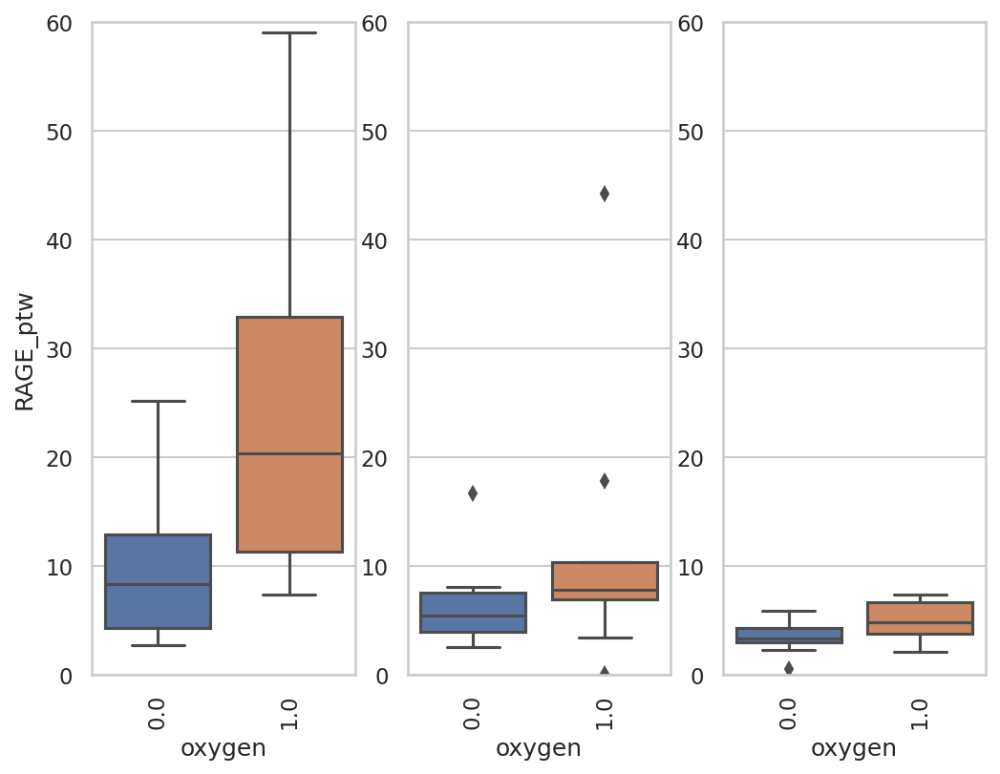

In [70]:
plt.figure(figsize=(8, 6))

sns.set(rc={'figure.figsize':(5, 8)})
sns.set_style("whitegrid")

plt.subplot("131")
ax = sns.boxplot(y="RAGE_ptw", x="oxygen", data=patient_mean[patient_mean.time == "admission"])
ax.set(ylim=(0, 60))
lab = ax.set_xticklabels(ax.get_xticklabels(), rotation=90)

plt.subplot("132")
ax = sns.boxplot(y="RAGE_ptw", x="oxygen", data=patient_mean[patient_mean.time == "discharge"])
ax.set(ylim=(0, 60))
lab = ax.set_xticklabels(ax.get_xticklabels(), rotation=90)
lab = ax.set_ylabel("")

plt.subplot("133")
ax = sns.boxplot(y="RAGE_ptw", x="oxygen", data=patient_mean[patient_mean.time == "post-1mo"])
ax.set(ylim=(0, 60))
lab = ax.set_xticklabels(ax.get_xticklabels(), rotation=90)
lab = ax.set_ylabel("")

In [71]:
x = patient_mean[(patient_mean.time == "admission") & (patient_mean.oxygen == 0)]["RAGE_ptw"]
y = patient_mean[(patient_mean.time == "admission") & (patient_mean.oxygen == 1)]["RAGE_ptw"]
scipy.stats.mannwhitneyu(x, y, alternative='two-sided')

MannwhitneyuResult(statistic=19.0, pvalue=0.022654494080089346)

In [72]:
x = patient_mean[(patient_mean.time == "discharge") & (patient_mean.oxygen == 0)]["RAGE_ptw"]
y = patient_mean[(patient_mean.time == "discharge") & (patient_mean.oxygen == 1)]["RAGE_ptw"]
scipy.stats.mannwhitneyu(x, y, alternative='two-sided')

MannwhitneyuResult(statistic=26.0, pvalue=0.21637300805763748)

In [73]:
x = patient_mean[(patient_mean.time == "post-1mo") & (patient_mean.oxygen == 0)]["RAGE_ptw"]
y = patient_mean[(patient_mean.time == "post-1mo") & (patient_mean.oxygen == 1)]["RAGE_ptw"]
scipy.stats.mannwhitneyu(x, y, alternative='two-sided')

MannwhitneyuResult(statistic=25.0, pvalue=0.11134688653314041)

## Comparison of RAGE_ptw score between patients with different hospitalization time

In [74]:
less_than_10days = ["P-17986", "P-18082", "P-19300", "P-18989", "P-17788", "P-19448", "P-18066", "P-19312", "P-17529", "P-16483"]

In [75]:
more_than_10days = ["P-19777", "P-20368", "P-17516", "P-19501", "P-19000", "P-17531", "P-18614", "P-20386", "P-19314", "P-20576", "P-19520", "P-19131", "P-20741", "P-17499", "P-18196", "P-18200"]

In [76]:
patient_mean["hospitalization"] = np.nan
patient_mean.loc[patient_mean.patient.isin(less_than_10days), "hospitalization"] = "< 10 days"
patient_mean.loc[patient_mean.patient.isin(more_than_10days), "hospitalization"] = "> 10 days"

In [77]:
patient_hospitalization = patient_mean[["patient", "hospitalization"]].drop_duplicates().sort_values(by="patient").set_index("patient")
patient_hospitalization

,hospitalization
patient,
P-16483,< 10 days
P-17531,> 10 days
P-17788,< 10 days
P-18066,< 10 days
P-18082,< 10 days
P-18196,> 10 days
P-18200,> 10 days
P-18989,< 10 days
P-19000,> 10 days


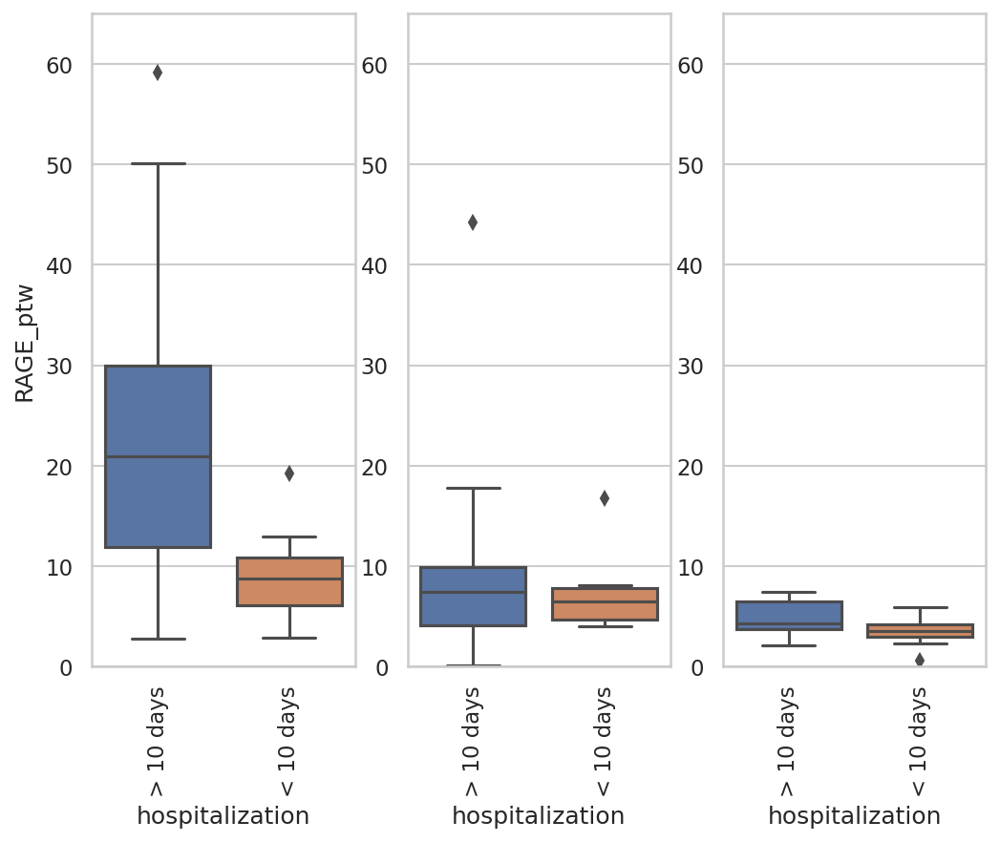

In [78]:
plt.figure(figsize=(8, 6))

sns.set(rc={'figure.figsize':(5, 8)})
sns.set_style("whitegrid")

plt.subplot("131")
ax = sns.boxplot(y="RAGE_ptw", x="hospitalization", data=patient_mean[patient_mean.time == "admission"])
ax.set(ylim=(0, 65))
lab = ax.set_xticklabels(ax.get_xticklabels(), rotation=90)

plt.subplot("132")
ax = sns.boxplot(y="RAGE_ptw", x="hospitalization", data=patient_mean[patient_mean.time == "discharge"])
ax.set(ylim=(0, 65))
lab = ax.set_xticklabels(ax.get_xticklabels(), rotation=90)
lab = ax.set_ylabel("")

plt.subplot("133")
ax = sns.boxplot(y="RAGE_ptw", x="hospitalization", data=patient_mean[patient_mean.time == "post-1mo"])
ax.set(ylim=(0, 65))
lab = ax.set_xticklabels(ax.get_xticklabels(), rotation=90)
lab = ax.set_ylabel("")


In [79]:
x = patient_mean[(patient_mean.time == "admission") & (patient_mean.hospitalization == "< 10 days")]["RAGE_ptw"]
y = patient_mean[(patient_mean.time == "admission") & (patient_mean.hospitalization == "> 10 days")]["RAGE_ptw"]
scipy.stats.mannwhitneyu(x, y, alternative='two-sided')

MannwhitneyuResult(statistic=19.0, pvalue=0.027890529120246504)

In [80]:
x = patient_mean[(patient_mean.time == "discharge") & (patient_mean.hospitalization == "< 10 days")]["RAGE_ptw"]
y = patient_mean[(patient_mean.time == "discharge") & (patient_mean.hospitalization == "> 10 days")]["RAGE_ptw"]
scipy.stats.mannwhitneyu(x, y, alternative='two-sided')

MannwhitneyuResult(statistic=36.0, pvalue=0.755813423086601)

In [81]:
x = patient_mean[(patient_mean.time == "post-1mo") & (patient_mean.hospitalization == "< 10 days")]["RAGE_ptw"]
y = patient_mean[(patient_mean.time == "post-1mo") & (patient_mean.hospitalization == "> 10 days")]["RAGE_ptw"]
scipy.stats.mannwhitneyu(x, y, alternative='two-sided')

MannwhitneyuResult(statistic=26.0, pvalue=0.1484536887497539)

## Comparison of RAGE_ptw score between patients with different age (above/below 60)

In [82]:
patient_mean[["patient", "age"]].drop_duplicates().sort_values(by="patient").set_index("patient")

,age
patient,
P-16483,71.0
P-17531,67.0
P-17788,55.0
P-18066,37.0
P-18082,48.0
P-18196,60.0
P-18200,72.0
P-18989,61.0
P-19000,84.0


In [83]:
patient_mean["above_or_below_60"] = np.nan
patient_mean.loc[patient_mean["age"] < 60, "above_or_below_60"] = "< 60"
patient_mean.loc[patient_mean["age"] >= 60, "above_or_below_60"] = ">= 60"

In [84]:
patient_age_group = patient_mean[["patient", "above_or_below_60"]].drop_duplicates().sort_values(by="patient").set_index("patient")
patient_age_group

,above_or_below_60
patient,
P-16483,>= 60
P-17531,>= 60
P-17788,< 60
P-18066,< 60
P-18082,< 60
P-18196,>= 60
P-18200,>= 60
P-18989,>= 60
P-19000,>= 60


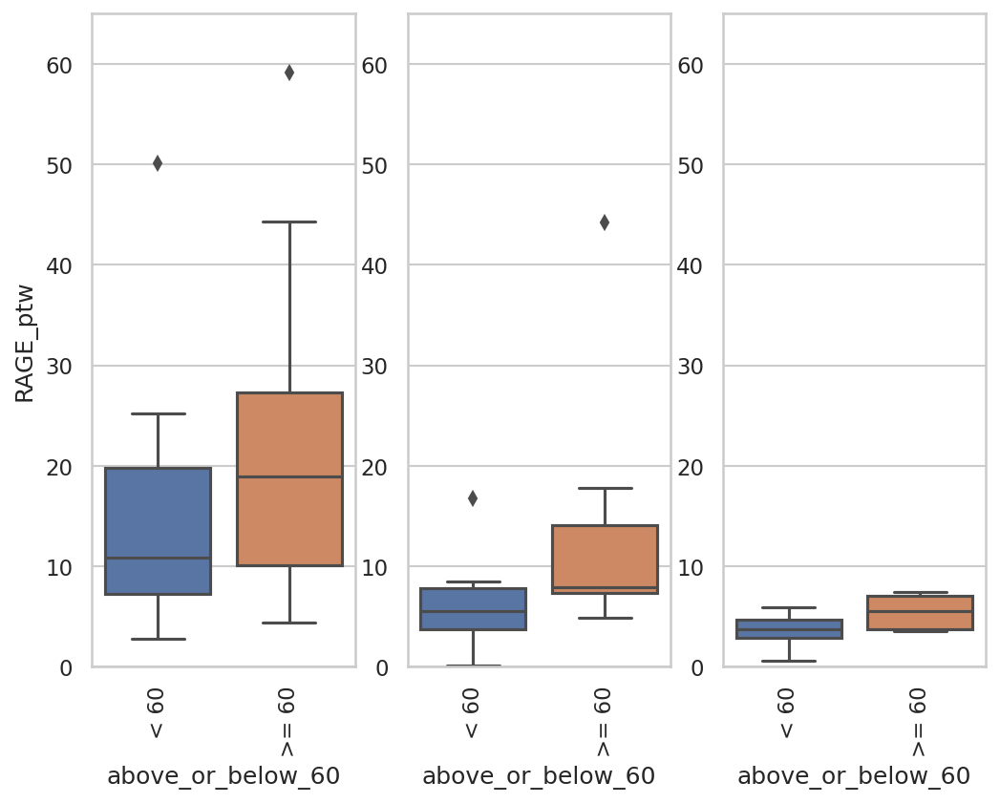

In [85]:
plt.figure(figsize=(8, 6))

sns.set(rc={'figure.figsize':(5, 8)})
sns.set_style("whitegrid")

plt.subplot("131")
ax = sns.boxplot(y="RAGE_ptw", x="above_or_below_60", data=patient_mean[patient_mean.time == "admission"])
ax.set(ylim=(0, 65))
lab = ax.set_xticklabels(ax.get_xticklabels(), rotation=90)

plt.subplot("132")
ax = sns.boxplot(y="RAGE_ptw", x="above_or_below_60", data=patient_mean[patient_mean.time == "discharge"])
ax.set(ylim=(0, 65))
lab = ax.set_xticklabels(ax.get_xticklabels(), rotation=90)
lab = ax.set_ylabel("")

plt.subplot("133")
ax = sns.boxplot(y="RAGE_ptw", x="above_or_below_60", data=patient_mean[patient_mean.time == "post-1mo"])
ax.set(ylim=(0, 65))
lab = ax.set_xticklabels(ax.get_xticklabels(), rotation=90)
lab = ax.set_ylabel("")

In [86]:
x = patient_mean[(patient_mean.time == "admission") & (patient_mean.above_or_below_60 == "< 60")]["RAGE_ptw"]
y = patient_mean[(patient_mean.time == "admission") & (patient_mean.above_or_below_60 == ">= 60")]["RAGE_ptw"]
scipy.stats.mannwhitneyu(x, y, alternative='two-sided')

MannwhitneyuResult(statistic=32.0, pvalue=0.23175472441333733)

In [87]:
x = patient_mean[(patient_mean.time == "discharge") & (patient_mean.above_or_below_60 == "< 60")]["RAGE_ptw"]
y = patient_mean[(patient_mean.time == "discharge") & (patient_mean.above_or_below_60 == ">= 60")]["RAGE_ptw"]
scipy.stats.mannwhitneyu(x, y, alternative='two-sided')

MannwhitneyuResult(statistic=17.0, pvalue=0.05718418553291404)

In [88]:
x = patient_mean[(patient_mean.time == "post-1mo") & (patient_mean.above_or_below_60 == "< 60")]["RAGE_ptw"]
y = patient_mean[(patient_mean.time == "post-1mo") & (patient_mean.above_or_below_60 == ">= 60")]["RAGE_ptw"]
scipy.stats.mannwhitneyu(x, y, alternative='two-sided')

MannwhitneyuResult(statistic=21.0, pvalue=0.08317279726072167)

## Comparison of RAGE_ptw score between patients with/without comorbidities

In [89]:
no_comorbidities = ["P-20368", "P-20386", "P-19312", "P-19314", "P-18196", "P-17788", "P-17529", "P-19131", "P-18614", "P-18066", "P-18082", "P-19448", "P-18200"]

In [90]:
comorbidities = ["P-19300", "P-20741", "P-19000", "P-19520", "P-17516", "P-20576", "P-16483", "P-17499", "P-17986", "P-17531", "P-19501", "P-19777", "P-18989"]

In [91]:
patient_mean["comorbidities"] = np.nan
patient_mean.loc[patient_mean.patient.isin(no_comorbidities), "comorbidities"] = "no"
patient_mean.loc[patient_mean.patient.isin(comorbidities), "comorbidities"] = "yes"

In [92]:
patient_comorbidities = patient_mean[["patient", "comorbidities"]].drop_duplicates().sort_values(by="patient").set_index("patient")
patient_comorbidities

,comorbidities
patient,
P-16483,yes
P-17531,yes
P-17788,no
P-18066,no
P-18082,no
P-18196,no
P-18200,no
P-18989,yes
P-19000,yes


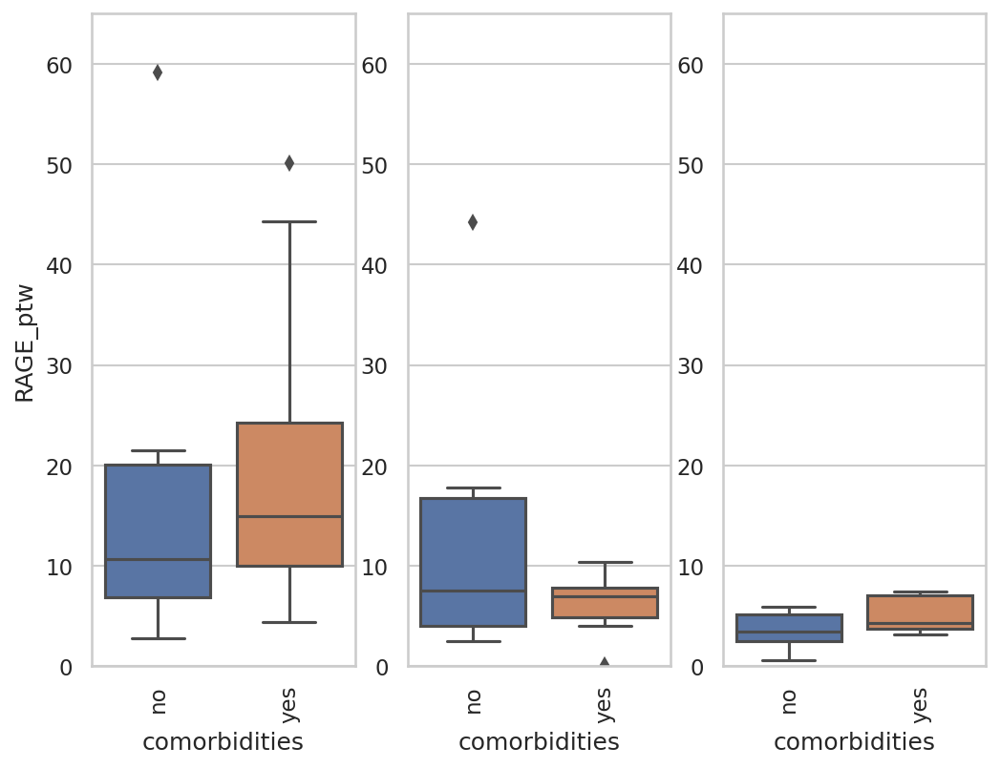

In [93]:
plt.figure(figsize=(8, 6))

sns.set(rc={'figure.figsize':(5, 8)})
sns.set_style("whitegrid")

plt.subplot("131")
ax = sns.boxplot(y="RAGE_ptw", x="comorbidities", data=patient_mean[patient_mean.time == "admission"])
ax.set(ylim=(0, 65))
lab = ax.set_xticklabels(ax.get_xticklabels(), rotation=90)

plt.subplot("132")
ax = sns.boxplot(y="RAGE_ptw", x="comorbidities", data=patient_mean[patient_mean.time == "discharge"])
ax.set(ylim=(0, 65))
lab = ax.set_xticklabels(ax.get_xticklabels(), rotation=90)
lab = ax.set_ylabel("")

plt.subplot("133")
ax = sns.boxplot(y="RAGE_ptw", x="comorbidities", data=patient_mean[patient_mean.time == "post-1mo"])
ax.set(ylim=(0, 65))
lab = ax.set_xticklabels(ax.get_xticklabels(), rotation=90)
lab = ax.set_ylabel("")

In [94]:
x = patient_mean[(patient_mean.time == "admission") & (patient_mean.comorbidities == "yes")]["RAGE_ptw"]
y = patient_mean[(patient_mean.time == "admission") & (patient_mean.comorbidities == "no")]["RAGE_ptw"]
scipy.stats.mannwhitneyu(x, y, alternative='two-sided')

MannwhitneyuResult(statistic=64.0, pvalue=0.3074894566186813)

In [95]:
x = patient_mean[(patient_mean.time == "discharge") & (patient_mean.comorbidities == "yes")]["RAGE_ptw"]
y = patient_mean[(patient_mean.time == "discharge") & (patient_mean.comorbidities == "no")]["RAGE_ptw"]
scipy.stats.mannwhitneyu(x, y, alternative='two-sided')

MannwhitneyuResult(statistic=35.0, pvalue=0.6588432549492806)

In [96]:
x = patient_mean[(patient_mean.time == "post-1mo") & (patient_mean.comorbidities == "yes")]["RAGE_ptw"]
y = patient_mean[(patient_mean.time == "post-1mo") & (patient_mean.comorbidities == "no")]["RAGE_ptw"]
scipy.stats.mannwhitneyu(x, y, alternative='two-sided')

MannwhitneyuResult(statistic=68.0, pvalue=0.06619257972219345)

## Pseudobulk computation

In [97]:
sc.settings.set_figure_params(dpi=150, facecolor="white")

In [98]:
adata_sub

AnnData object with n_obs × n_vars = 48539 × 15935
    obs: 'n_genes', 'sample_tag', 'patient', 'time', 'lab_id', 'DOB', 'sex', 'ht', 'VES', 'PCR', 'FIBRINOGENO', 'ANTITROMB', 'sCD40L', 'EGF', 'Eotaxin', 'FGF-2', 'FLT-3L', 'Fractalkine', 'G-CSF', 'GM-CSF', 'GROalpha', 'IFNalpha2', 'IFNgamma', 'IL-1alpha', 'IL-1beta', 'IL-1RA', 'IL-2', 'IL-3', 'IL-4', 'IL-5', 'IL-6', 'IL-7', 'IL-8', 'IL-9', 'IL-10', 'IL-12p40', 'IL-12p70', 'IL-13', 'IL-15', 'IL-17A', 'IL-17E/IL-25', 'IL-17F', 'IL-18', 'IL-22', 'IL-27', 'IP-10', 'MCP-1', 'MCP-3', 'M-CSF', 'MDC', 'MIG', 'MIP-1alpha', 'MIP-1beta', 'PDGF-AA', 'PDGF-AB/BB', 'TGFalpha', 'TNFalpha', 'TNFbeta', 'VEGF-A', 'IgA', 'IgG', 'days_from_symptoms_to_admission', 'severity', 'age', 'alcohol', 'smoke', 'fever', 'cough', 'pneumo', 'oxygen', 'comorbities', 'hypertension', 'batch_id', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_rb', 'pct_counts_rb', 'total_counts_ab', 'pct_counts_ab', 'leiden', 'leiden_abseq_harmony'

In [99]:
adata_sub.X = adata_sub.raw.X.copy()
sc.pp.normalize_total(adata_sub, target_sum=1e4)

normalizing counts per cell
    finished (0:00:00)


In [100]:
adata_sub

AnnData object with n_obs × n_vars = 48539 × 15935
    obs: 'n_genes', 'sample_tag', 'patient', 'time', 'lab_id', 'DOB', 'sex', 'ht', 'VES', 'PCR', 'FIBRINOGENO', 'ANTITROMB', 'sCD40L', 'EGF', 'Eotaxin', 'FGF-2', 'FLT-3L', 'Fractalkine', 'G-CSF', 'GM-CSF', 'GROalpha', 'IFNalpha2', 'IFNgamma', 'IL-1alpha', 'IL-1beta', 'IL-1RA', 'IL-2', 'IL-3', 'IL-4', 'IL-5', 'IL-6', 'IL-7', 'IL-8', 'IL-9', 'IL-10', 'IL-12p40', 'IL-12p70', 'IL-13', 'IL-15', 'IL-17A', 'IL-17E/IL-25', 'IL-17F', 'IL-18', 'IL-22', 'IL-27', 'IP-10', 'MCP-1', 'MCP-3', 'M-CSF', 'MDC', 'MIG', 'MIP-1alpha', 'MIP-1beta', 'PDGF-AA', 'PDGF-AB/BB', 'TGFalpha', 'TNFalpha', 'TNFbeta', 'VEGF-A', 'IgA', 'IgG', 'days_from_symptoms_to_admission', 'severity', 'age', 'alcohol', 'smoke', 'fever', 'cough', 'pneumo', 'oxygen', 'comorbities', 'hypertension', 'batch_id', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_rb', 'pct_counts_rb', 'total_counts_ab', 'pct_counts_ab', 'leiden', 'leiden_abseq_harmony'

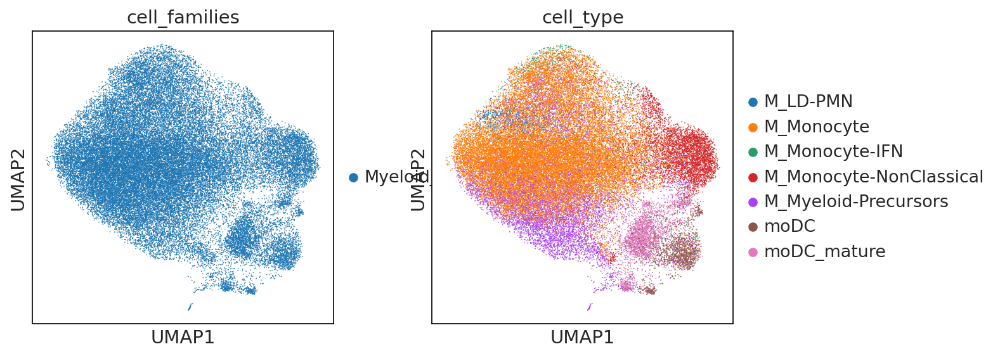

In [101]:
sc.pl.umap(adata_sub, color=["cell_families", "cell_type"])

In [102]:
total = pd.DataFrame()
metadata = pd.DataFrame()

for sample in adata.obs['patient_time'].cat.categories:

    dummy = adata_sub[adata_sub.obs['patient_time'] == sample].copy()
    if dummy.shape[0] < 20:
        continue
    
    if scipy.sparse.issparse(dummy.X):
        dummy.X = dummy.X.todense()

    df_sc = pd.DataFrame(
        index = dummy.obs_names.tolist(),
        data = dummy.X,
        columns = dummy.var_names.tolist()
    )
    df_sc = df_sc.sum(axis=0)

    total[sample] = df_sc
    metadata.loc[sample, "nr_of_cells"] = dummy.shape[0]


In [103]:
total

,P-16483_admission,P-16483_discharge,P-16483_post-1mo,P-17531_admission,P-17531_discharge,P-17531_post-1mo,P-17788_admission,P-17788_discharge,P-17788_post-1mo,P-18066_admission,...,P-20368_admission,P-20368_discharge,P-20368_post-1mo,P-20386_admission,P-20386_discharge,P-20386_post-1mo,P-20576_admission,P-20576_discharge,P-20576_post-1mo,P-crtl_control
ab_CD103|ITGAE|AHS0001|pAbO,1720.023682,2739.277588,1337.622925,571.249817,1617.839722,916.743164,1158.569702,778.345276,1347.852173,1433.757935,...,3488.779785,1648.742554,5652.103516,1131.245728,2.346680e+03,1382.262573,2447.360352,1424.604736,3091.335205,1671.819214
ab_CD10|MME|AHS0051|pAbO,2220.144775,4839.402832,2301.396484,2378.896973,10353.156250,5034.286133,1433.625610,970.471680,2526.251953,2640.759766,...,5974.412598,976.872681,3367.657715,3698.567871,3.558953e+03,2156.295166,4252.565430,8545.197266,13635.177734,883.333313
ab_CD117:YB5.B8|KIT|AHS0064|pAbO,13017.264648,23456.066406,7924.406738,5441.418945,16893.158203,9282.828125,8239.529297,4801.823242,10439.666992,10519.550781,...,42770.863281,19891.490234,71355.289062,14425.875977,3.289346e+04,15983.958984,21233.005859,14281.069336,27546.214844,21795.972656
ab_CD11b:ICRF44|ITGAM|AHS0184|pAbO,765270.187500,959482.187500,348705.000000,277093.218750,709370.062500,377988.500000,924797.937500,640132.375000,663377.500000,927993.625000,...,141254.500000,74072.000000,269504.218750,247476.781250,8.449591e+05,445248.218750,847375.000000,290734.093750,928403.187500,251282.312500
ab_CD11c:S-HCL-3|ITGAX|AHS0183|pAbO,589353.125000,941135.000000,449802.750000,227564.031250,536140.687500,306068.156250,597238.187500,433021.593750,669251.000000,743916.562500,...,195134.359375,117490.609375,367651.781250,308896.343750,1.054325e+06,637957.500000,497975.375000,259353.984375,782733.500000,284589.375000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
ZXDC,93.560715,177.207932,74.295441,40.797543,106.625908,72.331276,50.644150,39.811203,75.613121,90.265549,...,36.933475,11.199057,70.159561,89.073860,1.879166e+02,112.557060,132.033188,77.991684,199.050919,41.713142
ZYG11A,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.526177,0.000000,0.000000,1.139474,...,1.608752,0.000000,0.000000,0.000000,2.693022e-01,0.000000,1.604089,0.000000,0.636943,0.000000
ZYG11B,158.313995,233.968414,108.959747,78.016579,174.583725,93.841324,87.190353,66.895340,106.930336,170.695145,...,38.660885,22.145124,125.395988,59.153061,2.784070e+02,142.816284,199.613251,71.144508,376.684601,73.203773
ZYX,4918.655273,6306.468750,2107.478027,1965.874390,5177.041992,2862.402588,2956.531738,2198.645020,2612.323242,3357.410645,...,861.795593,502.112457,1900.523071,1926.549438,6.881541e+03,3452.850098,5189.160645,2061.515137,6494.779297,1240.722290


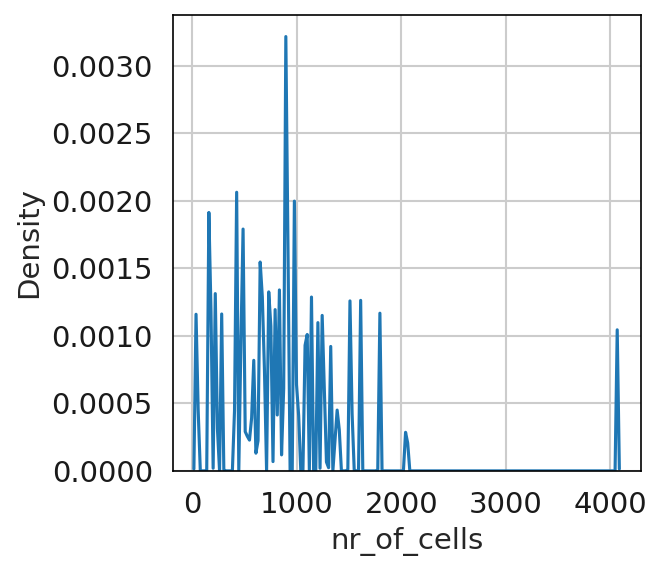

In [104]:
sns.kdeplot(metadata["nr_of_cells"], bw_adjust=0.02)
plt.show()

In [105]:
dummy = adata_sub.obs[['patient', 'time', 'lab_id', 'sex', 'days_from_symptoms_to_admission', 'severity', 'age', 
                       'alcohol', 'smoke', 'fever', 'cough', 'pneumo', 'oxygen', 'comorbities', 'batch_id',
                       'hypertension', 'age_bin', 'severity_coarse', 'severity_time', 'patient_time', 'mildness', 
                       'mildness_time', "time_code"]].drop_duplicates().set_index("patient_time")
metadata = metadata.join(dummy)

In [106]:
metadata

,nr_of_cells,patient,time,lab_id,sex,days_from_symptoms_to_admission,severity,age,alcohol,smoke,...,oxygen,comorbities,batch_id,hypertension,age_bin,severity_coarse,severity_time,mildness,mildness_time,time_code
P-16483_admission,1092.0,P-16483,admission,P0017,M,27.0,severe,71.0,0.0,0.0,...,1.0,2.0,O_WTA,1.0,70-80,sev+cri,sev+cri_admission,non-mild,non-mild_admission,1
P-16483_discharge,1610.0,P-16483,discharge,P0032,M,27.0,severe,71.0,0.0,0.0,...,1.0,2.0,O_WTA,1.0,70-80,sev+cri,sev+cri_discharge,non-mild,non-mild_discharge,2
P-16483_post-1mo,639.0,P-16483,post-1mo,P0122,M,27.0,severe,71.0,0.0,0.0,...,1.0,2.0,O_WTA,1.0,70-80,sev+cri,sev+cri_post-1mo,non-mild,non-mild_post-1mo,3
P-17531_admission,412.0,P-17531,admission,P0001,F,16.0,severe,67.0,0.0,0.0,...,1.0,5.0,I_WTA,1.0,60-70,sev+cri,sev+cri_admission,non-mild,non-mild_admission,1
P-17531_discharge,1085.0,P-17531,discharge,P0026,F,16.0,severe,67.0,0.0,0.0,...,1.0,5.0,I_WTA,1.0,60-70,sev+cri,sev+cri_discharge,non-mild,non-mild_discharge,2
P-17531_post-1mo,648.0,P-17531,post-1mo,P0119,F,16.0,severe,67.0,0.0,0.0,...,1.0,5.0,I_WTA,1.0,60-70,sev+cri,sev+cri_post-1mo,non-mild,non-mild_post-1mo,3
P-17788_admission,889.0,P-17788,admission,P0005,F,8.0,mild,55.0,0.0,0.0,...,0.0,0.0,N_WTA,0.0,50-60,mild,mild_admission,mild,mild_admission,1
P-17788_discharge,596.0,P-17788,discharge,P0012,F,8.0,mild,55.0,0.0,0.0,...,0.0,0.0,N_WTA,0.0,50-60,mild,mild_discharge,mild,mild_discharge,2
P-17788_post-1mo,839.0,P-17788,post-1mo,P0129,F,8.0,mild,55.0,0.0,0.0,...,0.0,0.0,N_WTA,0.0,50-60,mild,mild_post-1mo,mild,mild_post-1mo,3
P-18066_admission,981.0,P-18066,admission,P0010,F,8.0,mild,37.0,0.0,0.0,...,0.0,1.0,N_WTA,0.0,30-40,mild,mild_admission,mild,mild_admission,1


## Statistical analysis with EdgeR

In [107]:
import rpy2
import rpy2.robjects as ro

In [108]:
%load_ext rpy2.ipython

In [109]:
%%R
library(edgeR)

R[write to console]: Loading required package: limma



In [110]:
%%R
library(clusterProfiler)
library(org.Hs.eg.db)

R[write to console]: 

R[write to console]: clusterProfiler v3.18.1  For help: https://guangchuangyu.github.io/software/clusterProfiler

If you use clusterProfiler in published research, please cite:
Guangchuang Yu, Li-Gen Wang, Yanyan Han, Qing-Yu He. clusterProfiler: an R package for comparing biological themes among gene clusters. OMICS: A Journal of Integrative Biology. 2012, 16(5):284-287.

R[write to console]: 
Attaching package: ‘clusterProfiler’


R[write to console]: The following object is masked from ‘package:stats’:

    filter


R[write to console]: Loading required package: AnnotationDbi

R[write to console]: Loading required package: stats4

R[write to console]: Loading required package: BiocGenerics

R[write to console]: Loading required package: parallel

R[write to console]: 
Attaching package: ‘BiocGenerics’


R[write to console]: The following objects are masked from ‘package:parallel’:

    clusterApply, clusterApplyLB, clusterCall, clusterEvalQ,
    clusterExport,

In [111]:
%%R 
keytypes(org.Hs.eg.db)

 [1] "ACCNUM"       "ALIAS"        "ENSEMBL"      "ENSEMBLPROT"  "ENSEMBLTRANS"
 [6] "ENTREZID"     "ENZYME"       "EVIDENCE"     "EVIDENCEALL"  "GENENAME"    
[11] "GO"           "GOALL"        "IPI"          "MAP"          "OMIM"        
[16] "ONTOLOGY"     "ONTOLOGYALL"  "PATH"         "PFAM"         "PMID"        
[21] "PROSITE"      "REFSEQ"       "SYMBOL"       "UCSCKG"       "UNIGENE"     
[26] "UNIPROT"     


In [112]:
edgeR_topTags = ro.r['topTags']
edgeR_glmLRT = ro.r['glmLRT']
edgeR_glmQLFTest = ro.r['glmQLFTest']
as_data_frame = ro.r['as.data.frame']
rprint = rpy2.robjects.globalenv.find("print")

In [113]:
metadata["mild_vs_nonmild"] = metadata["mildness"].map({"non-mild": 1., "mild": 0.})
metadata["adm_vs_discharge"] = metadata["time"].map({"admission": 0., "discharge": 1.})
metadata["adm_vs_post1mo"] = metadata["time"].map({"admission": 0., "post-1mo": 1.})
metadata["time_code"] = (metadata["time_code"]-1)/2.
metadata

,nr_of_cells,patient,time,lab_id,sex,days_from_symptoms_to_admission,severity,age,alcohol,smoke,...,hypertension,age_bin,severity_coarse,severity_time,mildness,mildness_time,time_code,mild_vs_nonmild,adm_vs_discharge,adm_vs_post1mo
P-16483_admission,1092.0,P-16483,admission,P0017,M,27.0,severe,71.0,0.0,0.0,...,1.0,70-80,sev+cri,sev+cri_admission,non-mild,non-mild_admission,0.0,1.0,0.0,0.0
P-16483_discharge,1610.0,P-16483,discharge,P0032,M,27.0,severe,71.0,0.0,0.0,...,1.0,70-80,sev+cri,sev+cri_discharge,non-mild,non-mild_discharge,0.5,1.0,1.0,NaN
P-16483_post-1mo,639.0,P-16483,post-1mo,P0122,M,27.0,severe,71.0,0.0,0.0,...,1.0,70-80,sev+cri,sev+cri_post-1mo,non-mild,non-mild_post-1mo,1.0,1.0,NaN,1.0
P-17531_admission,412.0,P-17531,admission,P0001,F,16.0,severe,67.0,0.0,0.0,...,1.0,60-70,sev+cri,sev+cri_admission,non-mild,non-mild_admission,0.0,1.0,0.0,0.0
P-17531_discharge,1085.0,P-17531,discharge,P0026,F,16.0,severe,67.0,0.0,0.0,...,1.0,60-70,sev+cri,sev+cri_discharge,non-mild,non-mild_discharge,0.5,1.0,1.0,NaN
P-17531_post-1mo,648.0,P-17531,post-1mo,P0119,F,16.0,severe,67.0,0.0,0.0,...,1.0,60-70,sev+cri,sev+cri_post-1mo,non-mild,non-mild_post-1mo,1.0,1.0,NaN,1.0
P-17788_admission,889.0,P-17788,admission,P0005,F,8.0,mild,55.0,0.0,0.0,...,0.0,50-60,mild,mild_admission,mild,mild_admission,0.0,0.0,0.0,0.0
P-17788_discharge,596.0,P-17788,discharge,P0012,F,8.0,mild,55.0,0.0,0.0,...,0.0,50-60,mild,mild_discharge,mild,mild_discharge,0.5,0.0,1.0,NaN
P-17788_post-1mo,839.0,P-17788,post-1mo,P0129,F,8.0,mild,55.0,0.0,0.0,...,0.0,50-60,mild,mild_post-1mo,mild,mild_post-1mo,1.0,0.0,NaN,1.0
P-18066_admission,981.0,P-18066,admission,P0010,F,8.0,mild,37.0,0.0,0.0,...,0.0,30-40,mild,mild_admission,mild,mild_admission,0.0,0.0,0.0,0.0


In [114]:
n = len(metadata["batch_id"].cat.categories)
metadata["batch_id_code"] = metadata["batch_id"].map(dict(zip(metadata["batch_id"].cat.categories, np.array(range(n))/(n-1)))).astype(float)

### Mild vs non-mild at admission

In [115]:
metadata_selected = metadata[metadata["time"].isin(["admission"])]
metadata_selected["batch_id"] = metadata_selected["batch_id"].cat.remove_unused_categories()
metadata_selected.shape

(18, 27)

In [116]:
total_selected = total[metadata_selected.index]
total_selected.shape

(15935, 18)

In [117]:
%%R -i metadata_selected

mm <- model.matrix(~1 + metadata_selected$mild_vs_nonmild)
colnames(mm)

[1] "(Intercept)"                       "metadata_selected$mild_vs_nonmild"


In [118]:
with rpy2.robjects.conversion.localconverter(ro.default_converter + ro.pandas2ri.converter):
    total_selected_r = ro.pandas2ri.py2rpy(total_selected)

mm = rpy2.robjects.r["mm"]

mm = rpy2.robjects.r("`rownames<-`")(mm, list(total_selected.columns))
dds = rpy2.robjects.r["calcNormFactors"](rpy2.robjects.r["DGEList"](total_selected_r))
dds = rpy2.robjects.r["estimateDisp"](dds, mm)
dds = rpy2.robjects.r["glmFit"](dds, mm)

n_covariates = rpy2.robjects.r["ncol"](mm)[0]
covar_names = list(rpy2.robjects.r["colnames"](mm))
covar_names = [s.replace("metadata_selected$","").replace('"','') for s in list(covar_names)]

table_list = []
for i in range(n_covariates):
    
    deg_table = edgeR_topTags(edgeR_glmLRT(dds, coef=i+1), len(total_selected))
    deg_table = as_data_frame(deg_table)
    deg_table = rpy2.robjects.pandas2ri.rpy2py(deg_table)
    table_list.append(deg_table)
    
    n_significant = len(deg_table[(deg_table.FDR < 0.05)])
    print(covar_names[i], n_significant)

(Intercept) 15732
mild_vs_nonmild 3


In [119]:
admission_mild_vs_nonmild = pd.concat(table_list, axis=1, keys=covar_names)
admission_mild_vs_nonmild.to_csv(os.path.join(result_folder, "glm_results_mono_adm_mild_vs_nonmild.csv"))

In [121]:
rank = admission_mild_vs_nonmild[("mild_vs_nonmild", )]
rank.reset_index(inplace=True)
rank["rank_value"] = np.log(rank["FDR"]+1.E-99) * np.sign(rank["logFC"])
rank.sort_values("rank_value", ascending=False)

,index,logFC,logCPM,LR,PValue,FDR,rank_value
7135,MITF,-0.724143,2.616571,15.687911,0.000075,0.132261,2.022981
8451,ULK2,-0.576358,3.319697,15.288671,0.000092,0.147029,1.917123
10132,NID1,-0.806067,4.084207,13.102744,0.000295,0.252558,1.376113
4632,LLGL1,-1.371968,0.887718,13.107111,0.000294,0.252558,1.376113
7190,AKT3,-0.734717,2.661861,13.063312,0.000301,0.252558,1.376113
...,...,...,...,...,...,...,...
14879,MKI67,1.961069,1.139005,17.328289,0.000031,0.103503,-2.268155
15630,FCGR3B,3.044152,3.744141,17.026178,0.000037,0.103503,-2.268155
15341,IL1R2,2.303109,3.086645,20.187051,0.000007,0.037302,-3.288706
4124,GRB10,1.204618,1.318841,22.129536,0.000003,0.025776,-3.658323


In [122]:
%%R -i rank -o func_results

original_gene_list <- rank$rank_value
names(original_gene_list) <- rank$index
gene_list<-na.omit(original_gene_list)
gene_list = sort(gene_list, decreasing = TRUE)

gse <- gseGO(geneList=gene_list, 
             ont ="MF", 
             OrgDb = org.Hs.eg.db, 
             keyType = "SYMBOL", 
             nPerm = 1000, 
             minGSSize = 5, 
             maxGSSize = 100, 
             pvalueCutoff = 1., 
             verbose = TRUE, 
             pAdjustMethod = "none")

func_results = as.data.frame(gse@result)

R[write to console]: preparing geneSet collections...

R[write to console]: GSEA analysis...

R[write to console]: leading edge analysis...

R[write to console]: done...



In [123]:
func_results[func_results.ID == "GO:0050786"]

,ID,Description,setSize,enrichmentScore,NES,pvalue,p.adjust,qvalues,rank,leading_edge,core_enrichment
GO:0050786,GO:0050786,RAGE receptor binding,10,-0.954787,-1.900238,0.016097,0.016097,0.692521,584.0,"tags=70%, list=4%, signal=67%",HMGB2/S100B/FPR1/S100A12/S100P/S100A8/S100A9


### Mild: pattern over time

In [124]:
metadata_selected = metadata[(metadata["mildness"] == "mild") & (metadata["time"].isin(["admission", "discharge", "post-1mo"]))]
metadata_selected["batch_id"] = metadata_selected["batch_id"].cat.remove_unused_categories()
metadata_selected.shape

(30, 27)

In [125]:
total_selected = total[metadata_selected.index]
total_selected.shape

(15935, 30)

In [126]:
%%R -i metadata_selected

mm <- model.matrix(~1 + metadata_selected$time_code)
colnames(mm)

[1] "(Intercept)"                 "metadata_selected$time_code"


In [127]:
with rpy2.robjects.conversion.localconverter(ro.default_converter + ro.pandas2ri.converter):
    total_selected_r = ro.pandas2ri.py2rpy(total_selected)

mm = rpy2.robjects.r["mm"]

mm = rpy2.robjects.r("`rownames<-`")(mm, list(total_selected.columns))
dds = rpy2.robjects.r["calcNormFactors"](rpy2.robjects.r["DGEList"](total_selected_r))
dds = rpy2.robjects.r["estimateDisp"](dds, mm)
dds = rpy2.robjects.r["glmFit"](dds, mm)

n_covariates = rpy2.robjects.r["ncol"](mm)[0]
covar_names = list(rpy2.robjects.r["colnames"](mm))
covar_names = [s.replace("metadata_selected$","").replace('"','') for s in list(covar_names)]

table_list = []
for i in range(n_covariates):
    
    deg_table = edgeR_topTags(edgeR_glmLRT(dds, coef=i+1), len(total_selected))
    deg_table = as_data_frame(deg_table)
    deg_table = rpy2.robjects.pandas2ri.rpy2py(deg_table)
    table_list.append(deg_table)
    
    n_significant = len(deg_table[(deg_table.FDR < 0.05)])
    print(covar_names[i], n_significant)

(Intercept) 15143
time_code 102


In [128]:
mild_time_pattern = pd.concat(table_list, axis=1, keys=covar_names)
mild_time_pattern.to_csv(os.path.join(result_folder, "glm_results_mono_mild_over_time.csv"))

In [129]:
rank = mild_time_pattern[("time_code", )]
rank.reset_index(inplace=True)
rank["rank_value"] = np.log(rank["FDR"]+1.E-99) * np.sign(rank["logFC"])
rank.sort_values("rank_value", ascending=False)

,index,logFC,logCPM,LR,PValue,FDR,rank_value
15027,IFITM1,-3.434671,4.578809,34.374823,4.545656e-09,0.000036,10.225968
14913,USP18,-3.186477,2.798161,35.568282,2.462650e-09,0.000036,10.225968
15020,CLU,-3.264595,5.496601,30.411451,3.494591e-08,0.000181,8.617176
15138,IFI27,-6.223051,7.812381,29.902734,4.542718e-08,0.000181,8.617176
15041,RSAD2,-3.213137,4.962484,29.294715,6.216501e-08,0.000198,8.526638
...,...,...,...,...,...,...,...
4333,NECTIN1,0.865251,1.427121,18.679817,1.546104e-05,0.005866,-5.138584
8987,GPR155,0.636417,3.963174,18.842042,1.420023e-05,0.005604,-5.184320
5800,PRKAB2,0.640761,2.356180,20.125227,7.253362e-06,0.003728,-5.591759
10763,HIPK2,0.523136,4.780760,20.233207,6.855259e-06,0.003692,-5.601580


In [130]:
%%R -i rank -o func_results

original_gene_list <- rank$rank_value
names(original_gene_list) <- rank$index
gene_list<-na.omit(original_gene_list)
gene_list = sort(gene_list, decreasing = TRUE)

gse <- gseGO(geneList=gene_list, 
             ont ="MF", 
             OrgDb = org.Hs.eg.db, 
             keyType = "SYMBOL", 
             nPerm = 1000, 
             minGSSize = 5, 
             maxGSSize = 100, 
             pvalueCutoff = 1., 
             verbose = TRUE, 
             pAdjustMethod = "none")

func_results = as.data.frame(gse@result)

R[write to console]: preparing geneSet collections...

R[write to console]: GSEA analysis...

R[write to console]: leading edge analysis...

R[write to console]: done...



In [131]:
func_results[func_results.ID == "GO:0050786"]

,ID,Description,setSize,enrichmentScore,NES,pvalue,p.adjust,qvalues,rank,leading_edge,core_enrichment
GO:0050786,GO:0050786,RAGE receptor binding,10,0.823881,1.546317,0.031895,0.031895,0.548826,1168.0,"tags=50%, list=7%, signal=46%",S100A8/S100A9/HMGB2/S100A12/S100A4


### Non-mild: pattern over time

In [132]:
metadata_selected = metadata[(metadata["mildness"] == "non-mild") & (metadata["time"].isin(["admission", "discharge", "post-1mo"]))]
metadata_selected["batch_id"] = metadata_selected["batch_id"].cat.remove_unused_categories()
metadata_selected.shape

(24, 27)

In [133]:
total_selected = total[metadata_selected.index]
total_selected.shape

(15935, 24)

In [134]:
%%R -i metadata_selected

mm <- model.matrix(~1 + metadata_selected$time_code)
colnames(mm)

[1] "(Intercept)"                 "metadata_selected$time_code"


In [135]:
with rpy2.robjects.conversion.localconverter(ro.default_converter + ro.pandas2ri.converter):
    total_selected_r = ro.pandas2ri.py2rpy(total_selected)

mm = rpy2.robjects.r["mm"]

mm = rpy2.robjects.r("`rownames<-`")(mm, list(total_selected.columns))
dds = rpy2.robjects.r["calcNormFactors"](rpy2.robjects.r["DGEList"](total_selected_r))
dds = rpy2.robjects.r["estimateDisp"](dds, mm)
dds = rpy2.robjects.r["glmFit"](dds, mm)

n_covariates = rpy2.robjects.r["ncol"](mm)[0]
covar_names = list(rpy2.robjects.r["colnames"](mm))
covar_names = [s.replace("metadata_selected$","").replace('"','') for s in list(covar_names)]

table_list = []
for i in range(n_covariates):
    
    deg_table = edgeR_topTags(edgeR_glmLRT(dds, coef=i+1), len(total_selected))
    deg_table = as_data_frame(deg_table)
    deg_table = rpy2.robjects.pandas2ri.rpy2py(deg_table)
    table_list.append(deg_table)
    
    n_significant = len(deg_table[(deg_table.FDR < 0.05)])
    print(covar_names[i], n_significant)

(Intercept) 15731
time_code 404


In [136]:
nonmild_time_pattern = pd.concat(table_list, axis=1, keys=covar_names)
nonmild_time_pattern.to_csv(os.path.join(result_folder, "glm_results_mono_nonmild_over_time.csv"))

In [137]:
rank = nonmild_time_pattern[("time_code", )]
rank.reset_index(inplace=True)
rank["rank_value"] = np.log(rank["FDR"]+1.E-99) * np.sign(rank["logFC"])
rank.sort_values("rank_value", ascending=False)

,index,logFC,logCPM,LR,PValue,FDR,rank_value
15477,OASL,-3.194183,4.219136,35.181520,3.003603e-09,1.595414e-05,11.045792
15725,IFI27,-5.961089,7.202356,35.298994,2.827781e-09,1.595414e-05,11.045792
15676,SIGLEC1,-4.218914,5.448229,33.272284,8.011641e-09,3.191637e-05,10.352391
15213,IFI44,-2.315916,5.742482,32.053517,1.499833e-08,3.414263e-05,10.284964
15551,AXL,-4.636991,0.313974,32.126395,1.444612e-08,3.414263e-05,10.284964
...,...,...,...,...,...,...,...
7175,CHST2,1.351638,3.740945,22.794199,1.803091e-06,6.841015e-04,-7.287404
4534,PLD4,1.653271,2.230849,23.779623,1.080200e-06,5.683099e-04,-7.472844
6306,CDIP1,1.078767,3.105514,30.979267,2.607996e-08,4.155842e-05,-10.088411
13110,NAP1L1,1.147545,8.828784,32.427931,1.236957e-08,3.414263e-05,-10.284964


In [138]:
%%R -i rank -o func_results

original_gene_list <- rank$rank_value
names(original_gene_list) <- rank$index
gene_list<-na.omit(original_gene_list)
gene_list = sort(gene_list, decreasing = TRUE)

gse <- gseGO(geneList=gene_list, 
             ont ="MF", 
             OrgDb = org.Hs.eg.db, 
             keyType = "SYMBOL", 
             nPerm = 1000, 
             minGSSize = 5, 
             maxGSSize = 100, 
             pvalueCutoff = 1., 
             verbose = TRUE, 
             pAdjustMethod = "none")

func_results = as.data.frame(gse@result)

R[write to console]: preparing geneSet collections...

R[write to console]: GSEA analysis...

R[write to console]: leading edge analysis...

R[write to console]: done...



In [139]:
func_results[func_results.ID == "GO:0050786"]

,ID,Description,setSize,enrichmentScore,NES,pvalue,p.adjust,qvalues,rank,leading_edge,core_enrichment
GO:0050786,GO:0050786,RAGE receptor binding,10,0.861819,1.630771,0.010601,0.010601,0.553239,1453.0,"tags=60%, list=9%, signal=55%",S100A9/S100A8/HMGB2/S100A12/S100P/FPR1


# T cells

In [142]:
sc.settings.set_figure_params(dpi=150, facecolor="white")

## Restrict the dataset only to T cells

In [143]:
adata_sub = adata[(adata.obs.cell_families == "T_cells")]

In [144]:
sc.pp.neighbors(adata_sub, n_neighbors=20, n_pcs=40, use_rep="X_pca_harmony")

computing neighbors
        initialized `.distances` `.connectivities` 
    computing neighbors
    computed neighbors (0:00:23)
    computed connectivities (0:00:01)
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:25)


running Leiden clustering
    finished: found 12 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:21)
running PAGA
        initialized `.distances` `.connectivities` 
    finished: added
    'paga/connectivities', connectivities adjacency (adata.uns)
    'paga/connectivities_tree', connectivities subtree (adata.uns) (0:00:01)
--> added 'pos', the PAGA positions (adata.uns['paga'])


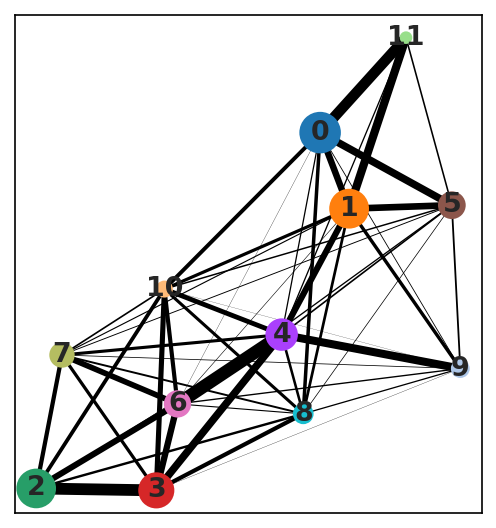

In [145]:
sc.tl.leiden(adata_sub)
sc.tl.paga(adata_sub)
sc.pl.paga(adata_sub)

In [146]:
sc.tl.umap(adata_sub, init_pos='paga')

computing UMAP


	completed  0  /  200 epochs
	completed  20  /  200 epochs
	completed  40  /  200 epochs
	completed  60  /  200 epochs
	completed  80  /  200 epochs
	completed  100  /  200 epochs
	completed  120  /  200 epochs
	completed  140  /  200 epochs
	completed  160  /  200 epochs
	completed  180  /  200 epochs


    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:36)


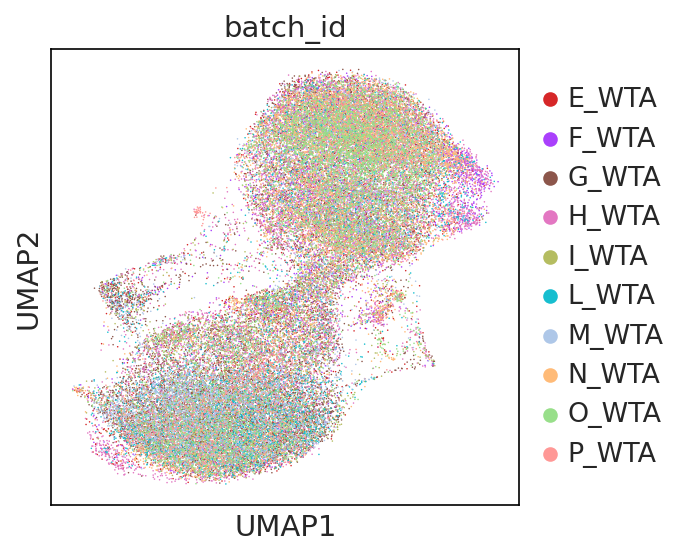

In [147]:
sc.pl.umap(adata_sub, color=['batch_id'])

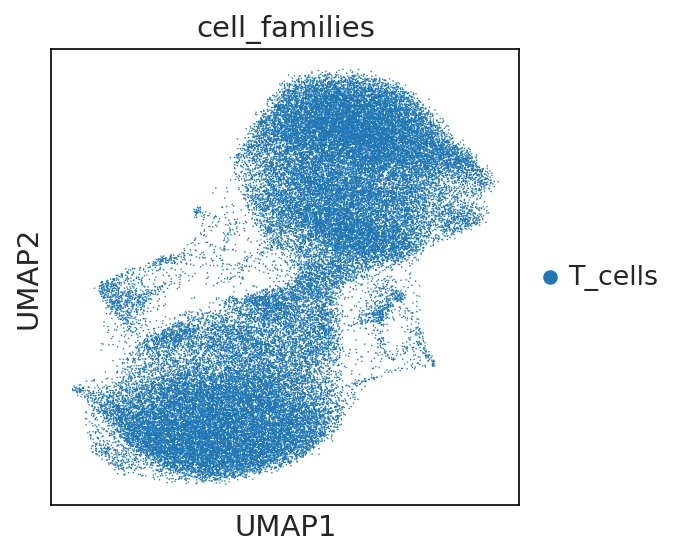

In [148]:
sc.pl.umap(adata_sub, color=['cell_families'], ncols=3, color_map="viridis", vmax="p98", vmin=0.)

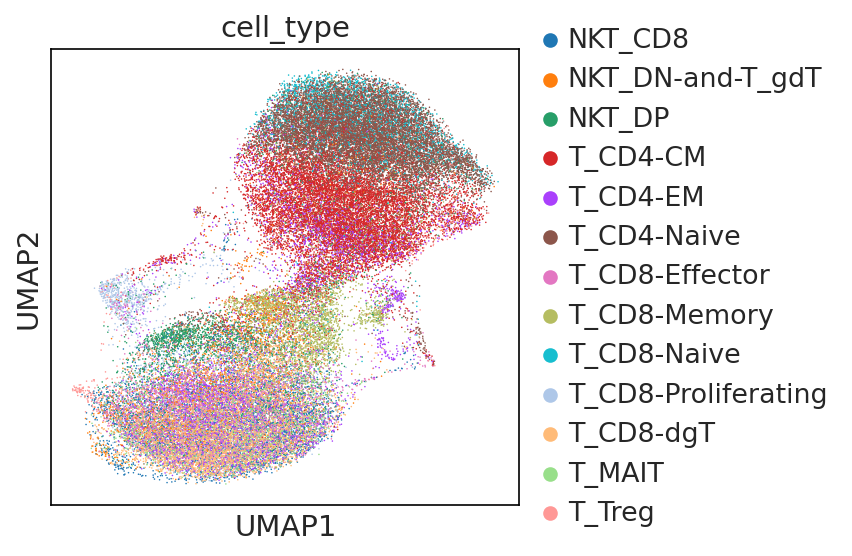

In [149]:
sc.pl.umap(adata_sub, color=['cell_type'], ncols=3, color_map="viridis", vmax="p98", vmin=0.)

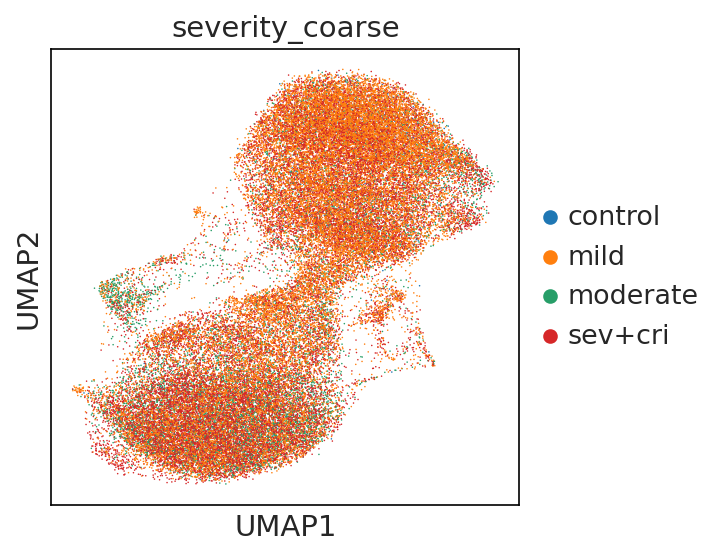

In [150]:
sc.pl.umap(adata_sub, color=['severity_coarse'], ncols=3, color_map="viridis", vmax="p98", vmin=0.)

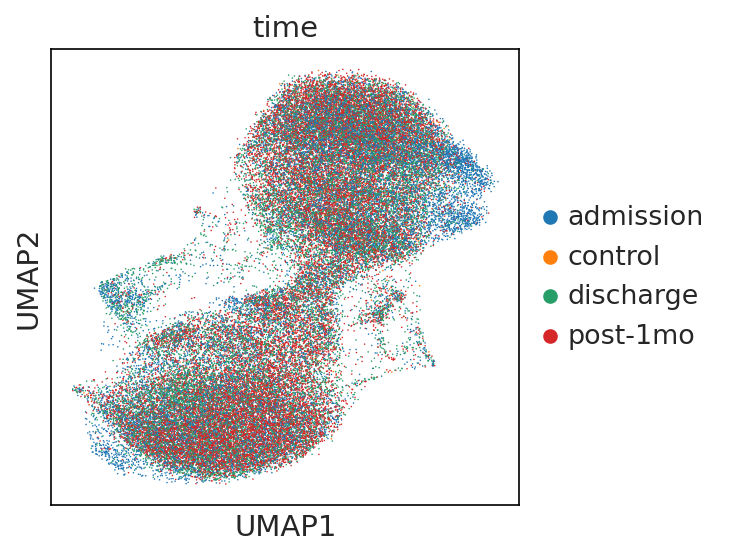

In [151]:
sc.pl.umap(adata_sub, color=['time'], ncols=3, color_map="viridis", vmax="p98", vmin=0.)

## Genes expression levels and pathway score

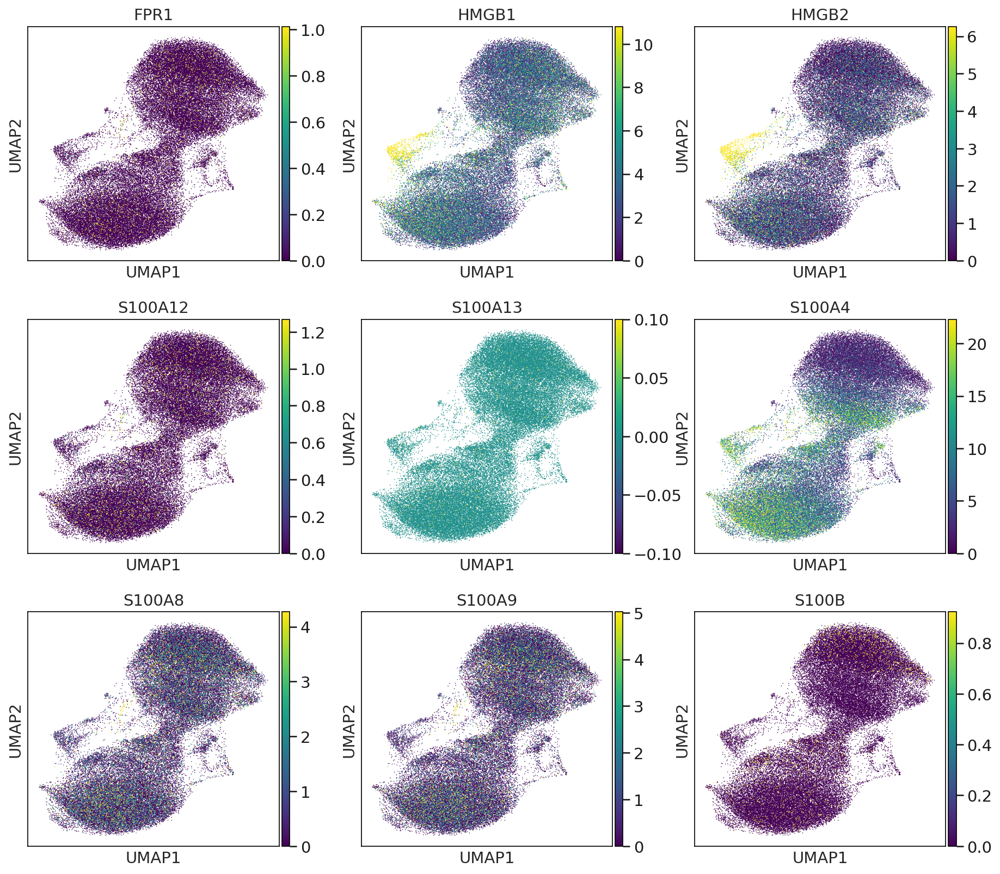

In [152]:
sc.pl.umap(adata_sub, color=rage_pathway_genes, ncols=3, color_map="viridis", vmax="p98", vmin=0., use_raw=False)

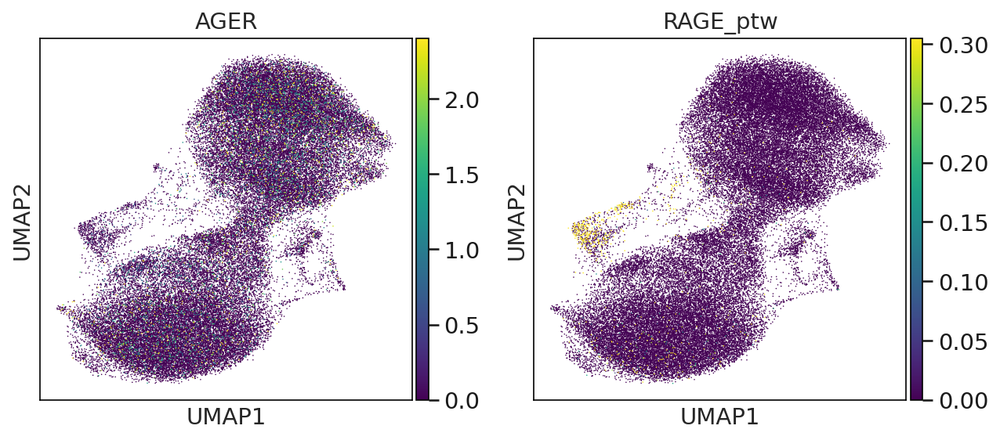

In [153]:
sc.pl.umap(adata_sub, color=["AGER", "RAGE_ptw"], ncols=3, color_map="viridis", vmax="p99", vmin=0., use_raw=False)

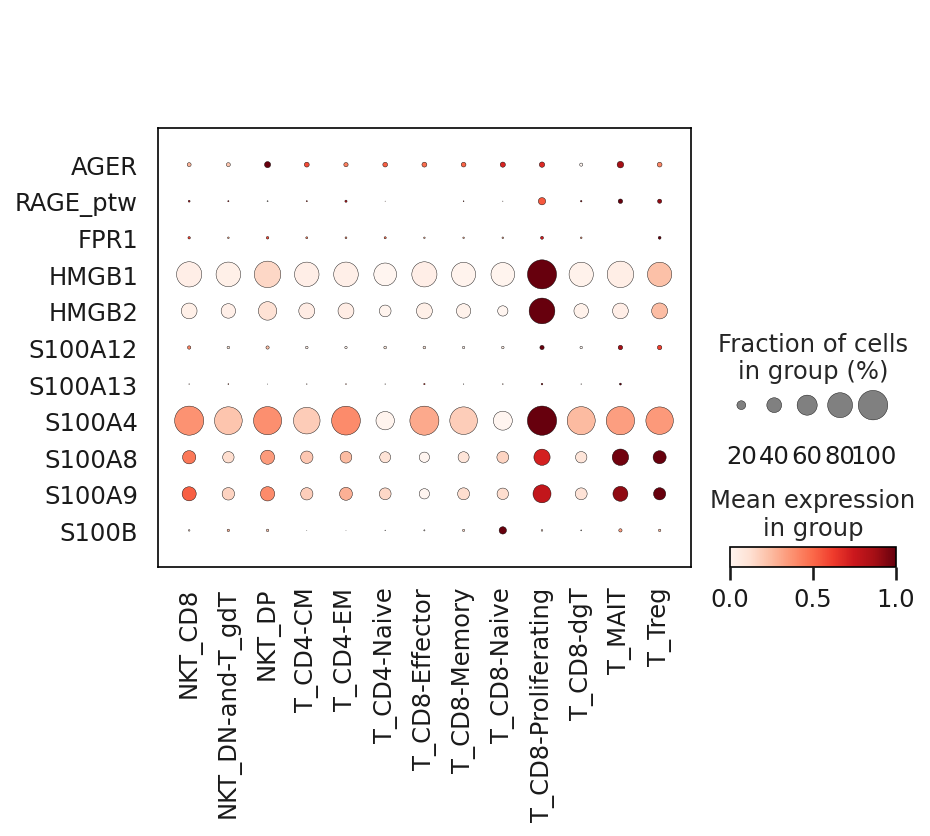

In [154]:
sc.pl.dotplot(adata_sub[(adata_sub.obs.time == "admission")],
              var_names=["AGER", "RAGE_ptw"] + rage_pathway_genes, groupby='cell_type', 
              use_raw=True, expression_cutoff=0, swap_axes=True, standard_scale="var")

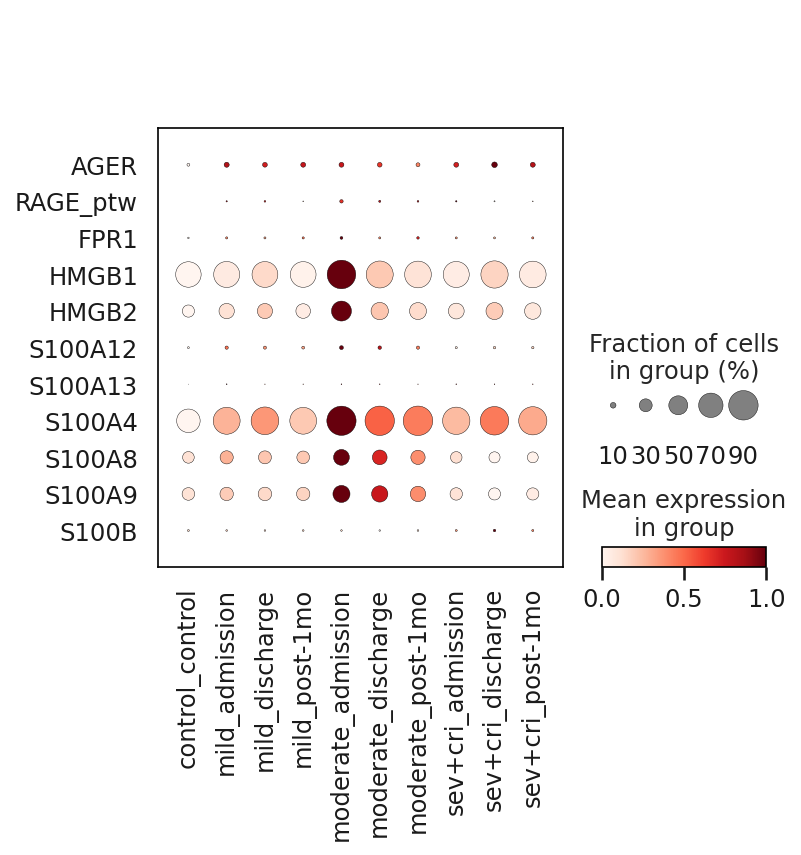

In [155]:
sc.pl.dotplot(adata_sub, var_names=["AGER", "RAGE_ptw"] + rage_pathway_genes,
              groupby='severity_time', use_raw=True, expression_cutoff=0, swap_axes=True, standard_scale="var")

## Dotplots grouped by patients-time for the different severities separately

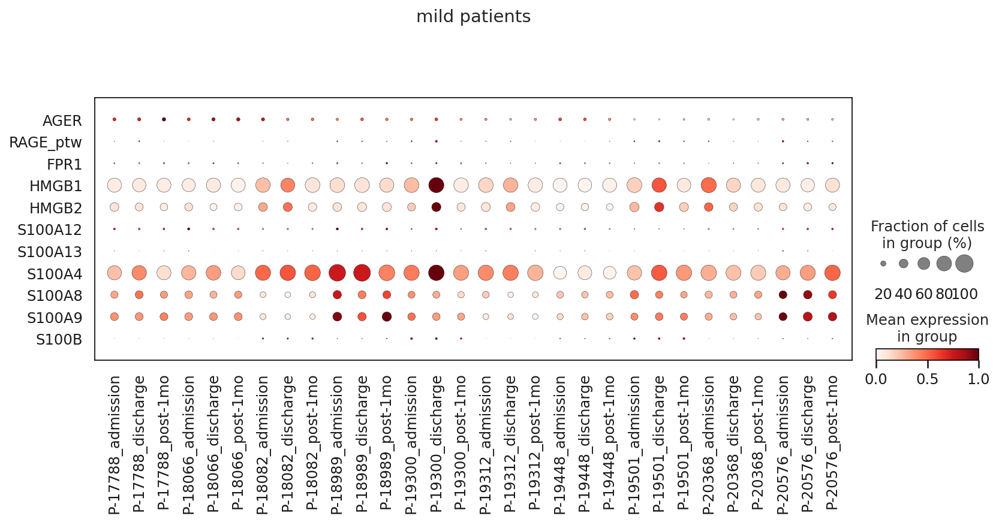

In [156]:
sc.pl.dotplot(adata_sub[(adata_sub.obs.severity_coarse == "mild")], title="mild patients",
              var_names=["AGER", "RAGE_ptw"] + rage_pathway_genes, groupby='patient_time', use_raw=True, 
              expression_cutoff=0, swap_axes=True, standard_scale="var")

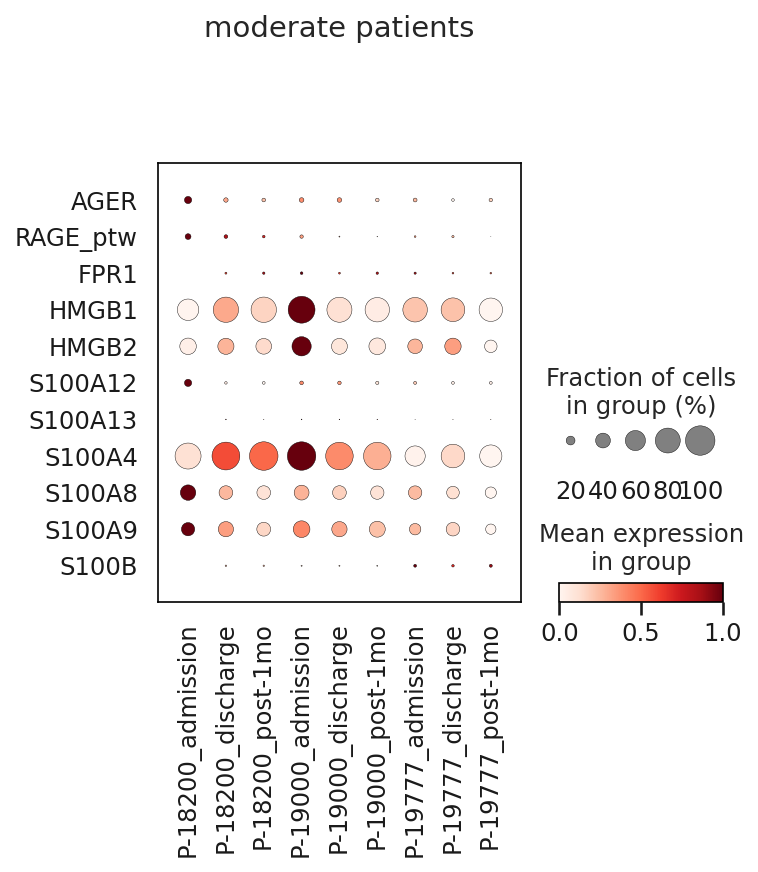

In [157]:
sc.pl.dotplot(adata_sub[(adata_sub.obs.severity_coarse == "moderate")], title="moderate patients",
              var_names=["AGER", "RAGE_ptw"] + rage_pathway_genes, groupby='patient_time', 
              use_raw=True, expression_cutoff=0, swap_axes=True, standard_scale="var")

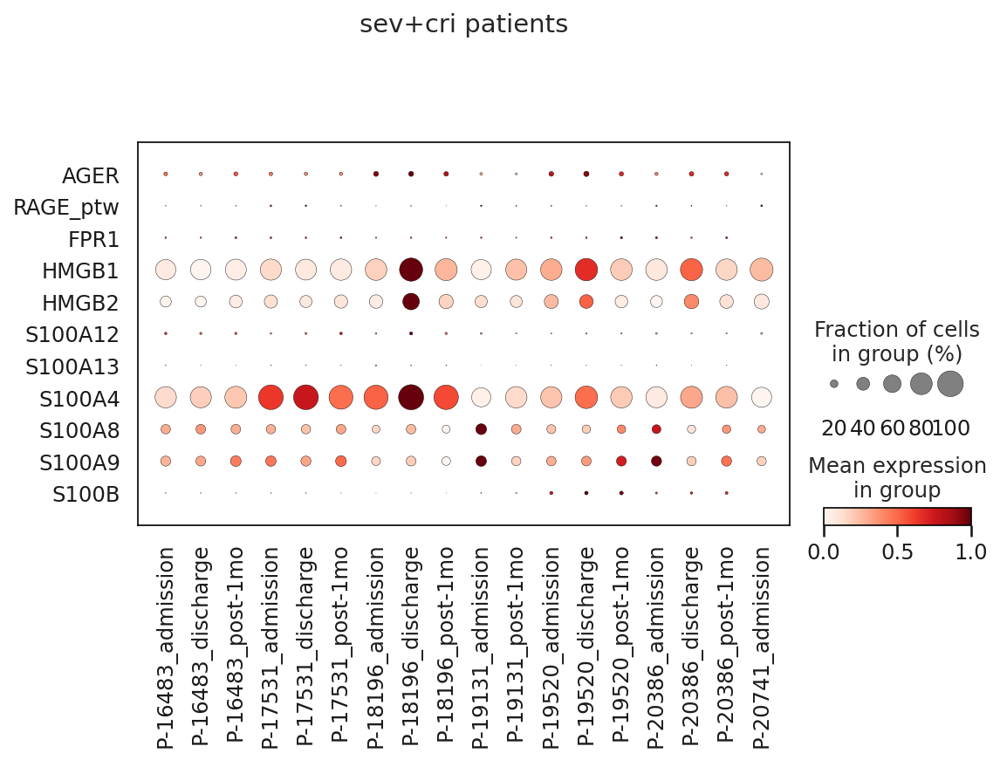

In [158]:
sc.pl.dotplot(adata_sub[(adata_sub.obs.severity_coarse == "sev+cri")], title="sev+cri patients",
              var_names=["AGER", "RAGE_ptw"] + rage_pathway_genes,
              groupby='patient_time', use_raw=True, expression_cutoff=0, swap_axes=True, standard_scale="var")

## Dotplots grouped by patients for the different time points separately

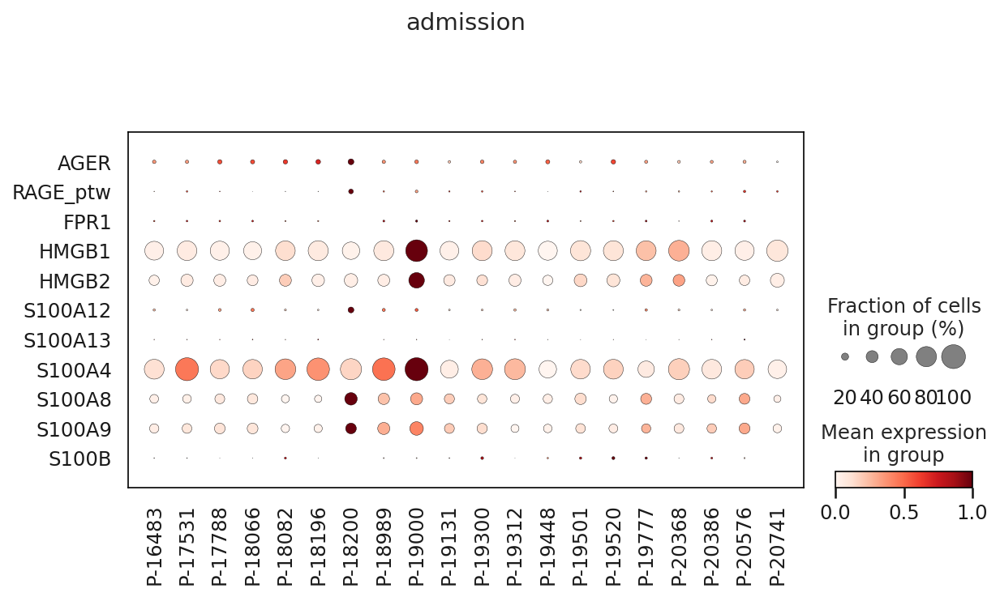

In [159]:
sc.pl.dotplot(adata_sub[(adata_sub.obs.time == "admission")], 
              var_names=["AGER", "RAGE_ptw"] + rage_pathway_genes, groupby='patient', 
              use_raw=True, expression_cutoff=0, swap_axes=True, standard_scale="var", title="admission")

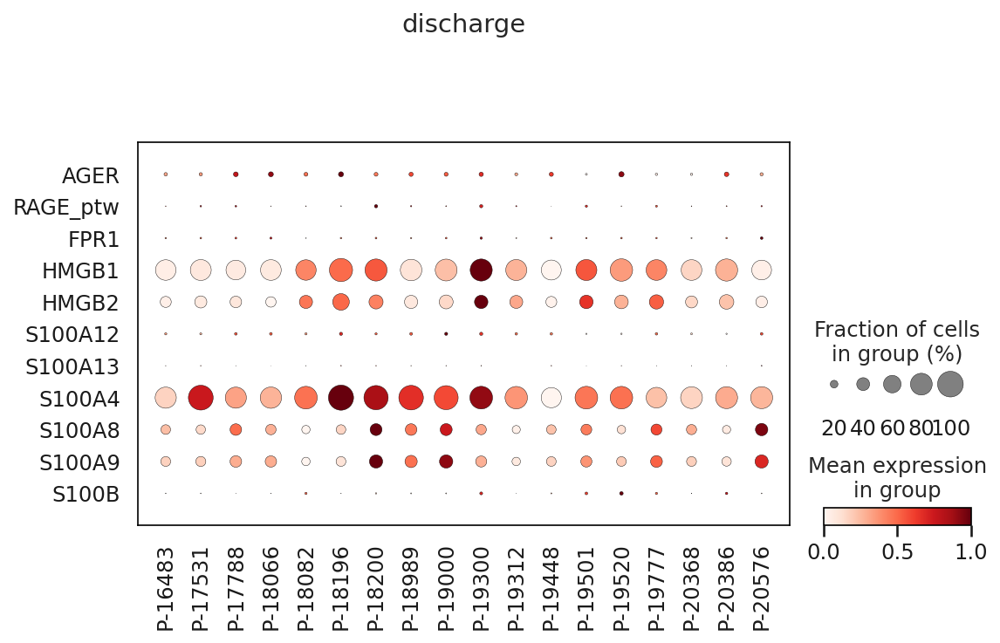

In [160]:
sc.pl.dotplot(adata_sub[(adata_sub.obs.time == "discharge")], var_names=["AGER", "RAGE_ptw"] + rage_pathway_genes,
              groupby='patient', use_raw=True, expression_cutoff=0, swap_axes=True, standard_scale="var", title="discharge")

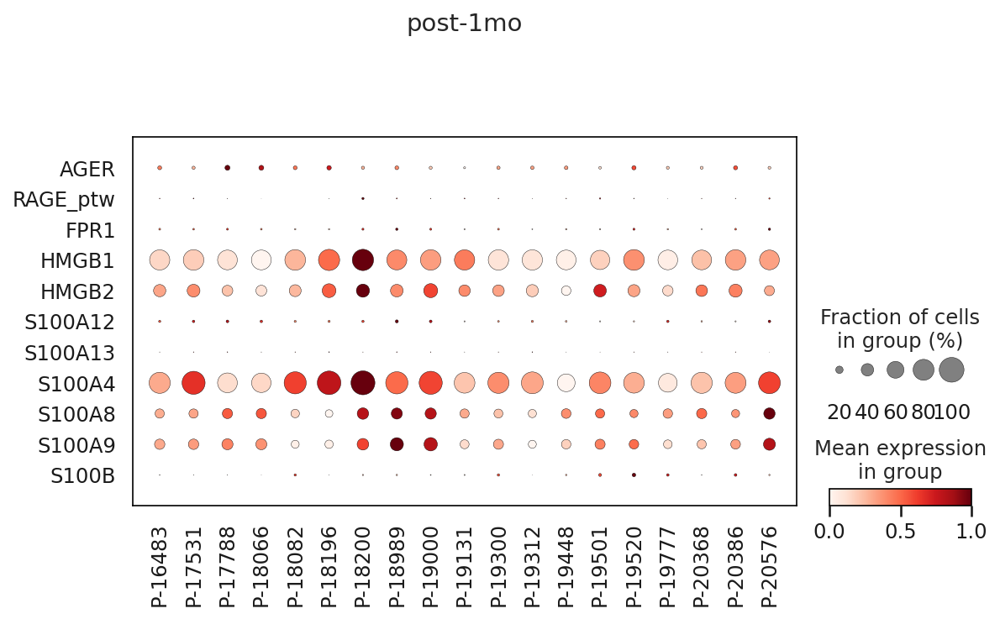

In [161]:
sc.pl.dotplot(adata_sub[(adata_sub.obs.time == "post-1mo")], var_names=["AGER", "RAGE_ptw"] + rage_pathway_genes,
              groupby='patient', use_raw=True, expression_cutoff=0, swap_axes=True, standard_scale="var", title="post-1mo")

## RAGE pathway average score

In [162]:
patient_metadata = ["severity_coarse", "patient", "time", "severity_time", "oxygen", "age", 'mildness_time', 'mildness']

In [163]:
patient_mean = adata_sub.obs[patient_metadata + ["RAGE_ptw"]].groupby(by=patient_metadata, observed=True, dropna=True).mean()
patient_mean.reset_index(inplace=True)

for i in patient_mean.columns:
    try:
        patient_mean[i] = patient_mean[i].cat.remove_unused_categories()
    except AttributeError:
        pass
    
patient_mean

,severity_coarse,patient,time,severity_time,oxygen,age,mildness_time,mildness,RAGE_ptw
0,mild,P-19501,discharge,mild_discharge,0.0,48.0,mild_discharge,mild,-2.369698
1,mild,P-19501,post-1mo,mild_post-1mo,0.0,48.0,mild_post-1mo,mild,-2.170145
2,mild,P-19501,admission,mild_admission,0.0,48.0,mild_admission,mild,-1.776635
3,mild,P-20368,discharge,mild_discharge,0.0,30.0,mild_discharge,mild,-2.641682
4,mild,P-20368,post-1mo,mild_post-1mo,0.0,30.0,mild_post-1mo,mild,-2.709683
5,mild,P-20368,admission,mild_admission,0.0,30.0,mild_admission,mild,-2.577120
6,mild,P-18989,discharge,mild_discharge,0.0,61.0,mild_discharge,mild,-2.084264
7,mild,P-18989,post-1mo,mild_post-1mo,0.0,61.0,mild_post-1mo,mild,-2.425934
8,mild,P-18989,admission,mild_admission,0.0,61.0,mild_admission,mild,-2.137009
9,mild,P-19300,discharge,mild_discharge,0.0,55.0,mild_discharge,mild,-2.273232


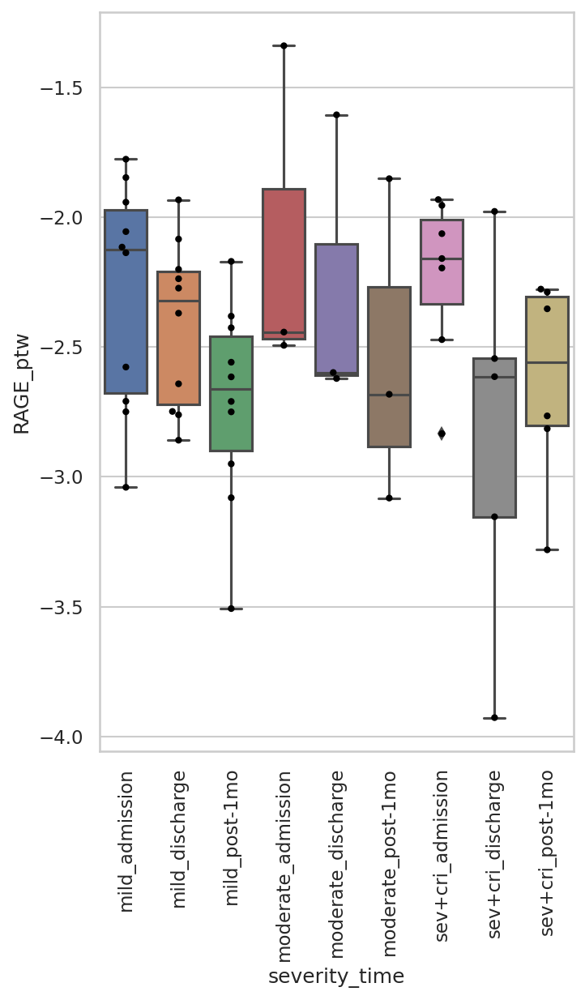

In [164]:
sns.set(rc={'figure.figsize':(5, 8)})
sns.set_style("whitegrid")
ax = sns.boxplot(y="RAGE_ptw", x="severity_time", data=patient_mean)
ax2 = sns.swarmplot(y="RAGE_ptw", x="severity_time", data=patient_mean, size=4, color="black")
lab = ax.set_xticklabels(ax.get_xticklabels(), rotation=90)

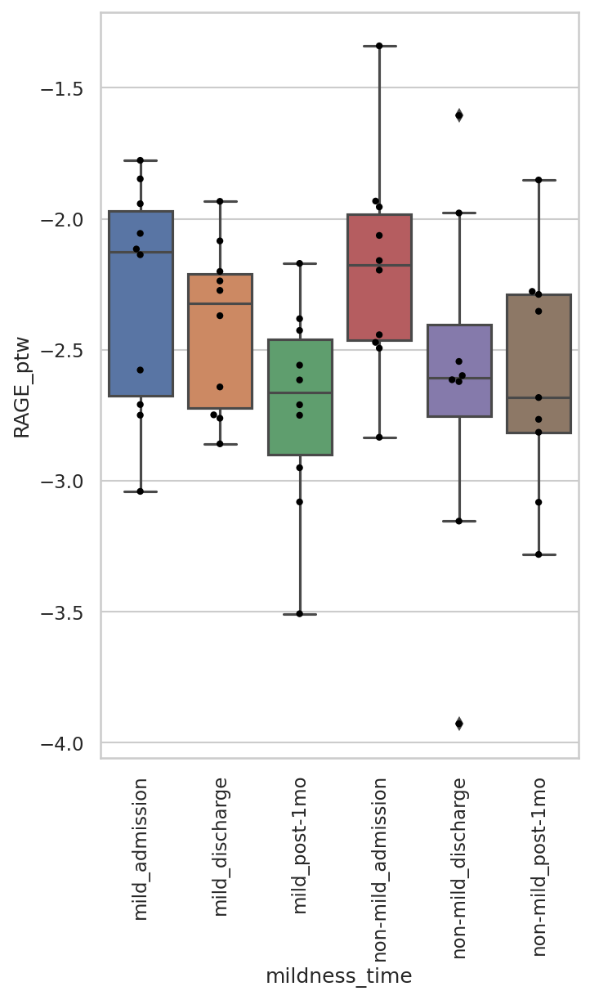

In [165]:
sns.set(rc={'figure.figsize':(5, 8)})
sns.set_style("whitegrid")
ax = sns.boxplot(y="RAGE_ptw", x="mildness_time", data=patient_mean)
ax2 = sns.swarmplot(y="RAGE_ptw", x="mildness_time", data=patient_mean, size=4, color="black")
lab = ax.set_xticklabels(ax.get_xticklabels(), rotation=90)

# B cells

In [166]:
sc.settings.set_figure_params(dpi=150, facecolor="white")

## Restrict the dataset only to B cells

In [167]:
adata_sub = adata[(adata.obs.cell_families == "B_cells")]

In [168]:
sc.pp.neighbors(adata_sub, n_neighbors=20, n_pcs=40, use_rep="X_pca_harmony")

computing neighbors
        initialized `.distances` `.connectivities` 
    computing neighbors
    computed neighbors (0:00:04)
    computed connectivities (0:00:00)
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:05)


running Leiden clustering
    finished: found 14 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:02)
running PAGA
        initialized `.distances` `.connectivities` 
    finished: added
    'paga/connectivities', connectivities adjacency (adata.uns)
    'paga/connectivities_tree', connectivities subtree (adata.uns) (0:00:00)
--> added 'pos', the PAGA positions (adata.uns['paga'])


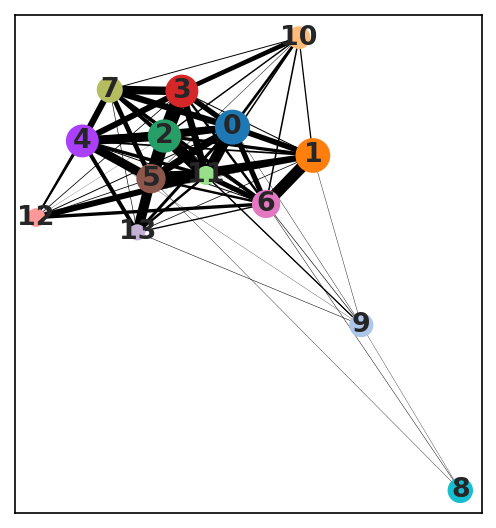

In [169]:
sc.tl.leiden(adata_sub)
sc.tl.paga(adata_sub)
sc.pl.paga(adata_sub)

In [170]:
sc.tl.umap(adata_sub, init_pos='paga')

computing UMAP


	completed  0  /  200 epochs
	completed  20  /  200 epochs
	completed  40  /  200 epochs
	completed  60  /  200 epochs
	completed  80  /  200 epochs
	completed  100  /  200 epochs
	completed  120  /  200 epochs
	completed  140  /  200 epochs
	completed  160  /  200 epochs
	completed  180  /  200 epochs


    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:09)


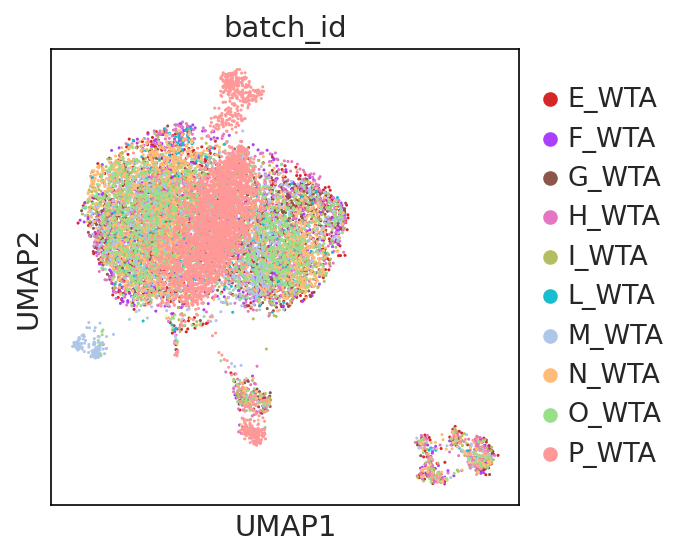

In [171]:
sc.pl.umap(adata_sub, color=['batch_id'])

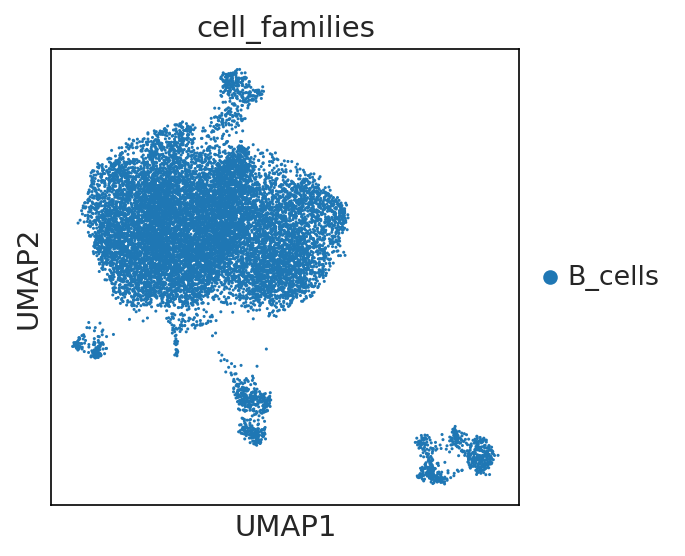

In [172]:
sc.pl.umap(adata_sub, color=['cell_families'], ncols=3, color_map="viridis", vmax="p98", vmin=0.)

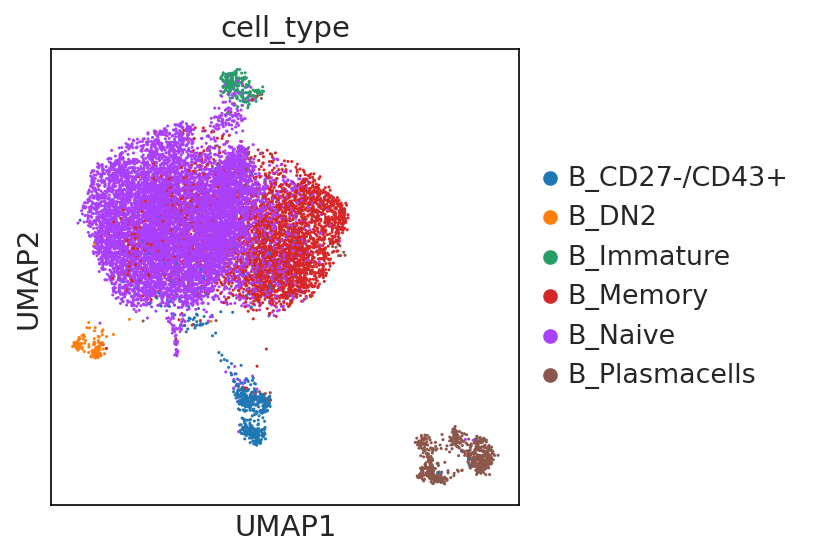

In [173]:
sc.pl.umap(adata_sub, color=['cell_type'], ncols=3, color_map="viridis", vmax="p98", vmin=0.)

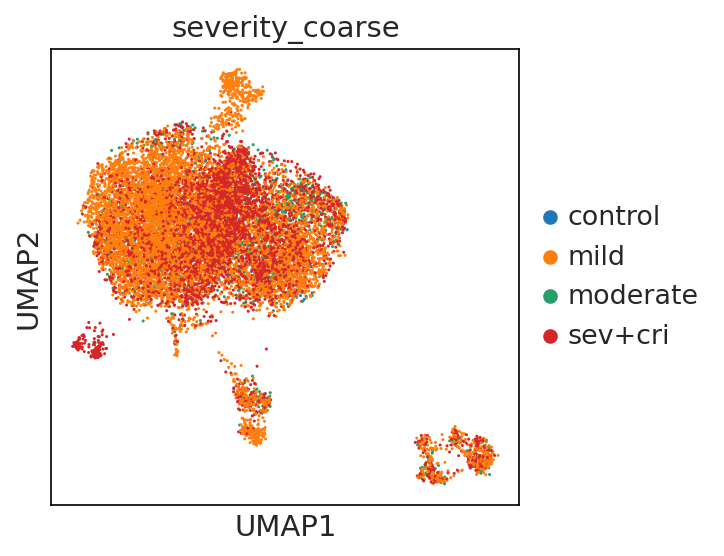

In [174]:
sc.pl.umap(adata_sub, color=['severity_coarse'], ncols=3, color_map="viridis", vmax="p98", vmin=0.)

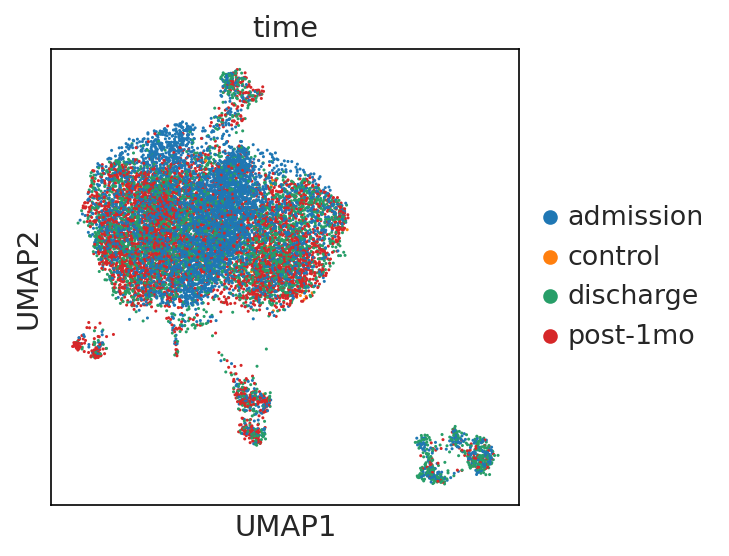

In [175]:
sc.pl.umap(adata_sub, color=['time'], ncols=3, color_map="viridis", vmax="p98", vmin=0.)

## Genes expression levels and pathway score

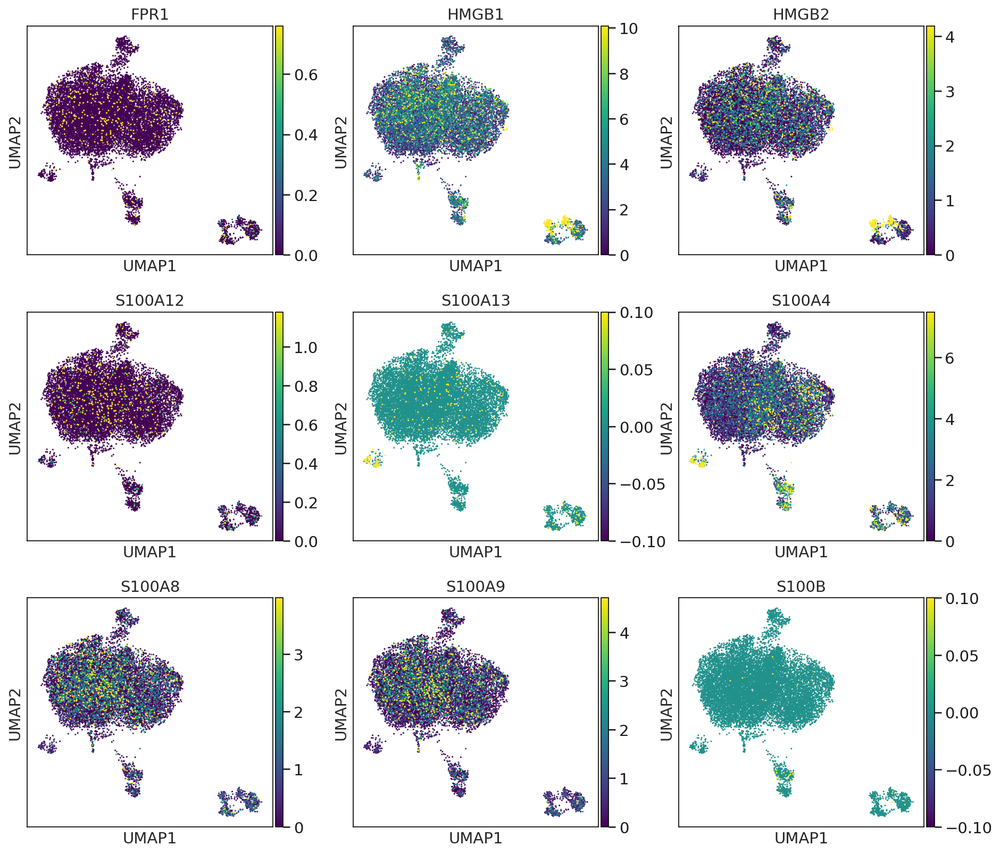

In [176]:
sc.pl.umap(adata_sub, color=rage_pathway_genes, ncols=3, color_map="viridis", vmax="p98", vmin=0., use_raw=False)

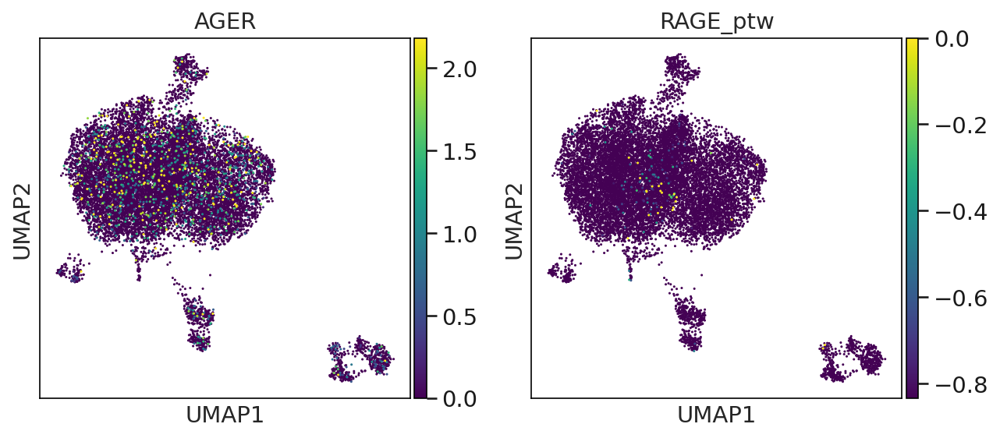

In [177]:
sc.pl.umap(adata_sub, color=["AGER", "RAGE_ptw"], ncols=3, color_map="viridis", vmax="p99", vmin=0., use_raw=False)

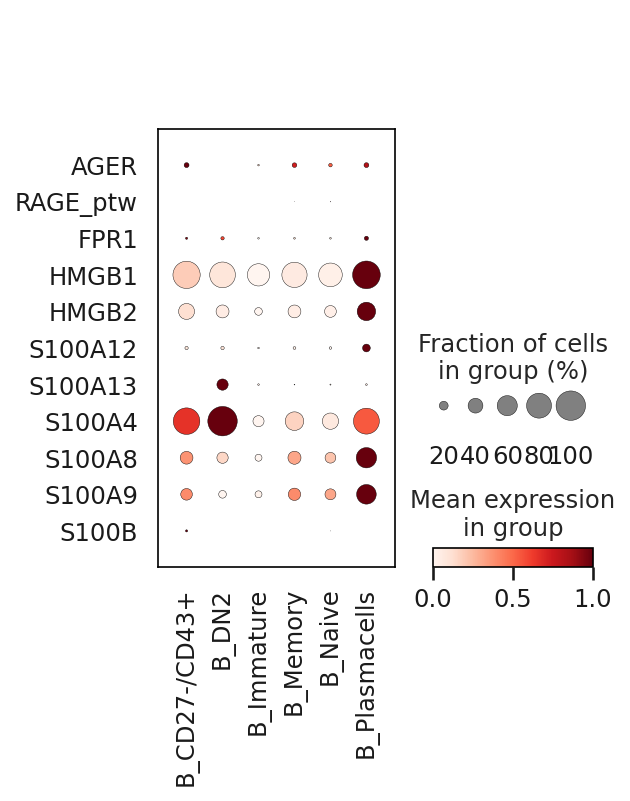

In [178]:
sc.pl.dotplot(adata_sub[(adata_sub.obs.time == "admission")],
              var_names=["AGER", "RAGE_ptw"] + rage_pathway_genes, groupby='cell_type', 
              use_raw=True, expression_cutoff=0, swap_axes=True, standard_scale="var")

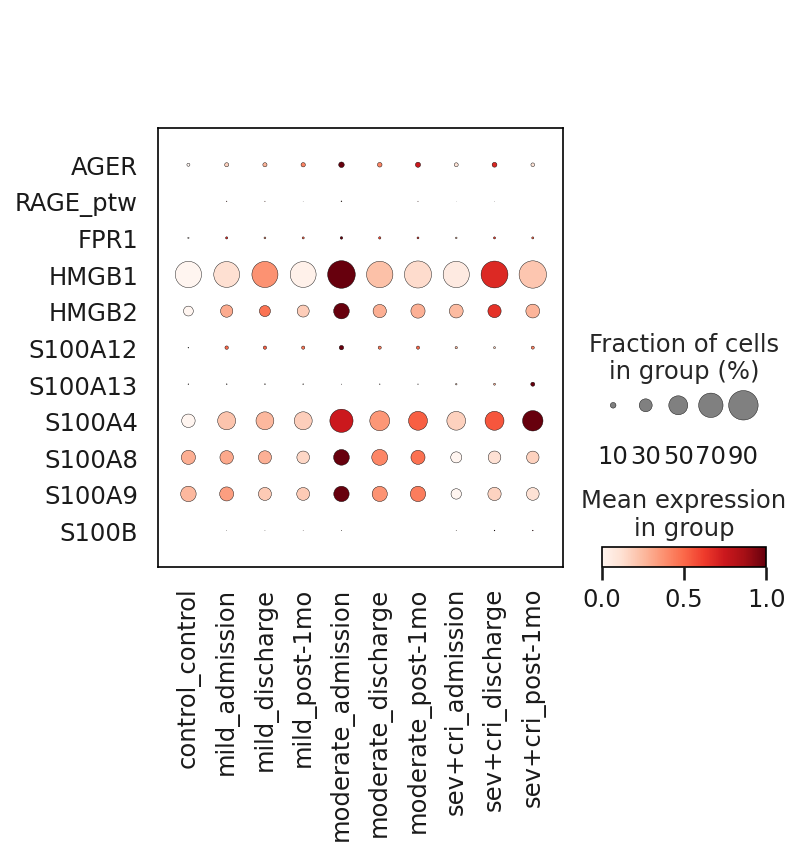

In [179]:
sc.pl.dotplot(adata_sub, var_names=["AGER", "RAGE_ptw"] + rage_pathway_genes,
              groupby='severity_time', use_raw=True, expression_cutoff=0, swap_axes=True, standard_scale="var")

## Dotplots grouped by patients-time for the different severities separately

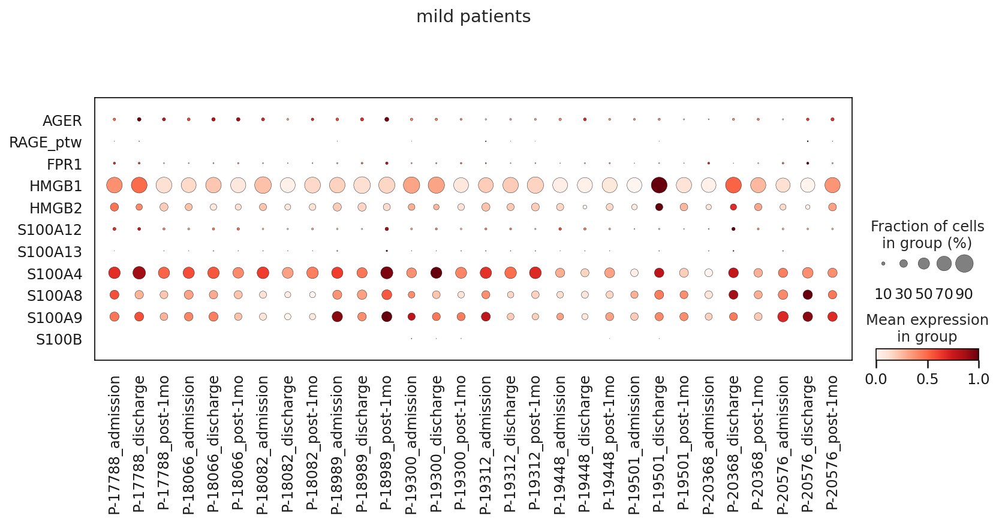

In [180]:
sc.pl.dotplot(adata_sub[(adata_sub.obs.severity_coarse == "mild")], title="mild patients",
              var_names=["AGER", "RAGE_ptw"] + rage_pathway_genes, groupby='patient_time', use_raw=True, 
              expression_cutoff=0, swap_axes=True, standard_scale="var")

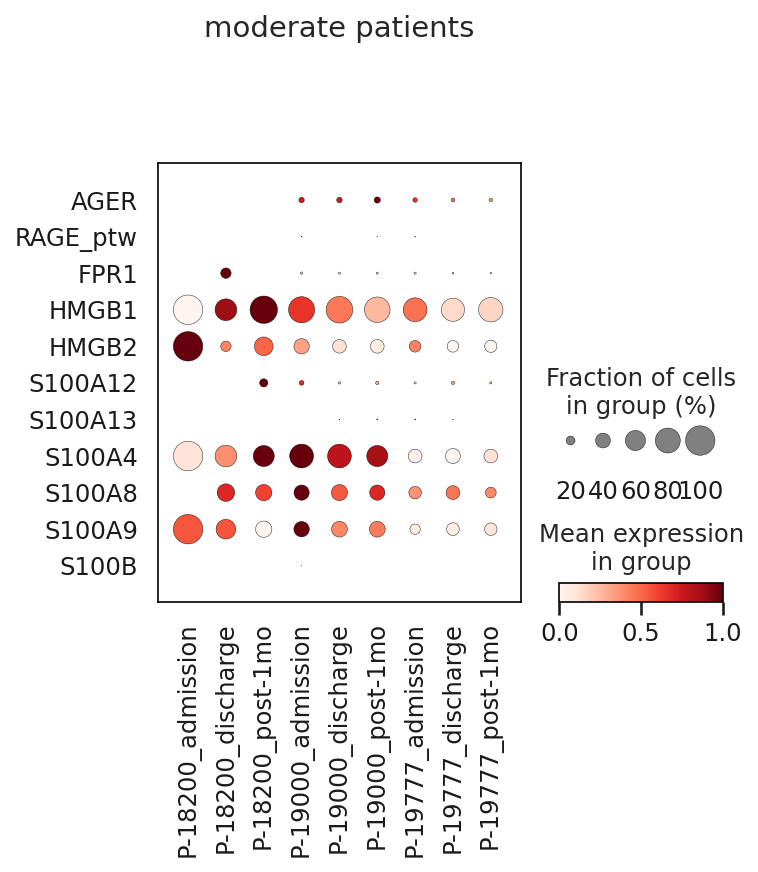

In [181]:
sc.pl.dotplot(adata_sub[(adata_sub.obs.severity_coarse == "moderate")], title="moderate patients",
              var_names=["AGER", "RAGE_ptw"] + rage_pathway_genes, groupby='patient_time', 
              use_raw=True, expression_cutoff=0, swap_axes=True, standard_scale="var")

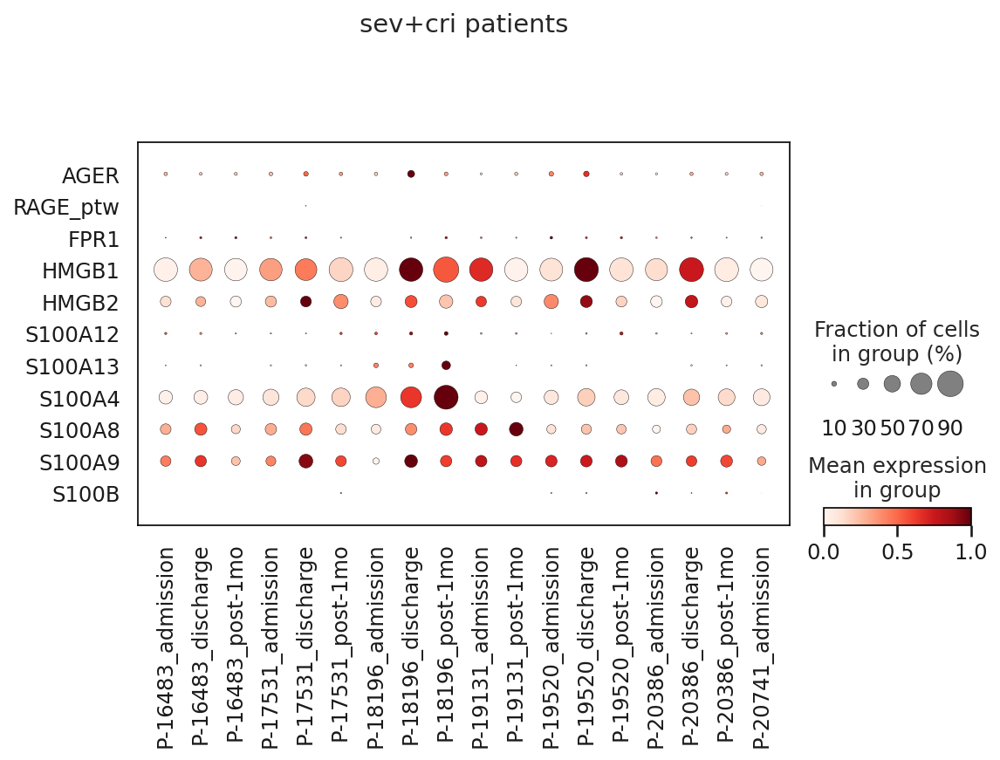

In [182]:
sc.pl.dotplot(adata_sub[(adata_sub.obs.severity_coarse == "sev+cri")], title="sev+cri patients",
              var_names=["AGER", "RAGE_ptw"] + rage_pathway_genes,
              groupby='patient_time', use_raw=True, expression_cutoff=0, swap_axes=True, standard_scale="var")

## Dotplots grouped by patients for the different time points separately

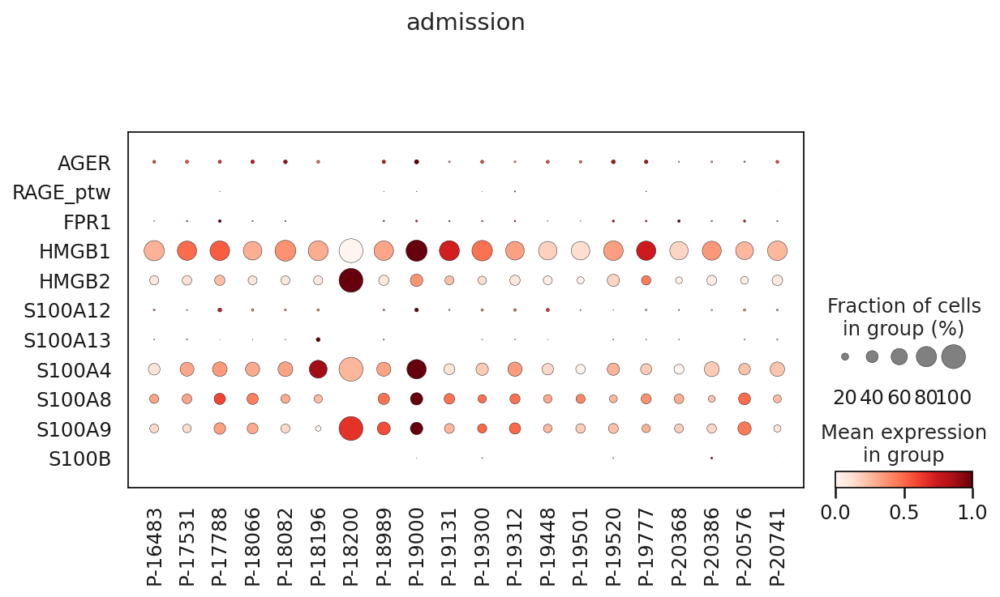

In [183]:
sc.pl.dotplot(adata_sub[(adata_sub.obs.time == "admission")], 
              var_names=["AGER", "RAGE_ptw"] + rage_pathway_genes, groupby='patient', 
              use_raw=True, expression_cutoff=0, swap_axes=True, standard_scale="var", title="admission")

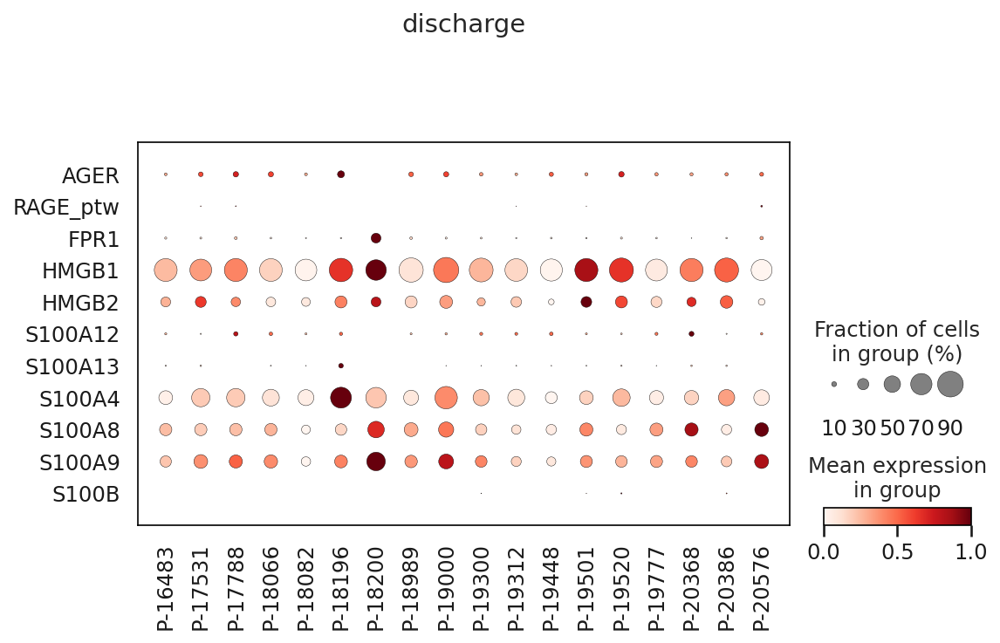

In [184]:
sc.pl.dotplot(adata_sub[(adata_sub.obs.time == "discharge")], var_names=["AGER", "RAGE_ptw"] + rage_pathway_genes,
              groupby='patient', use_raw=True, expression_cutoff=0, swap_axes=True, standard_scale="var", title="discharge")

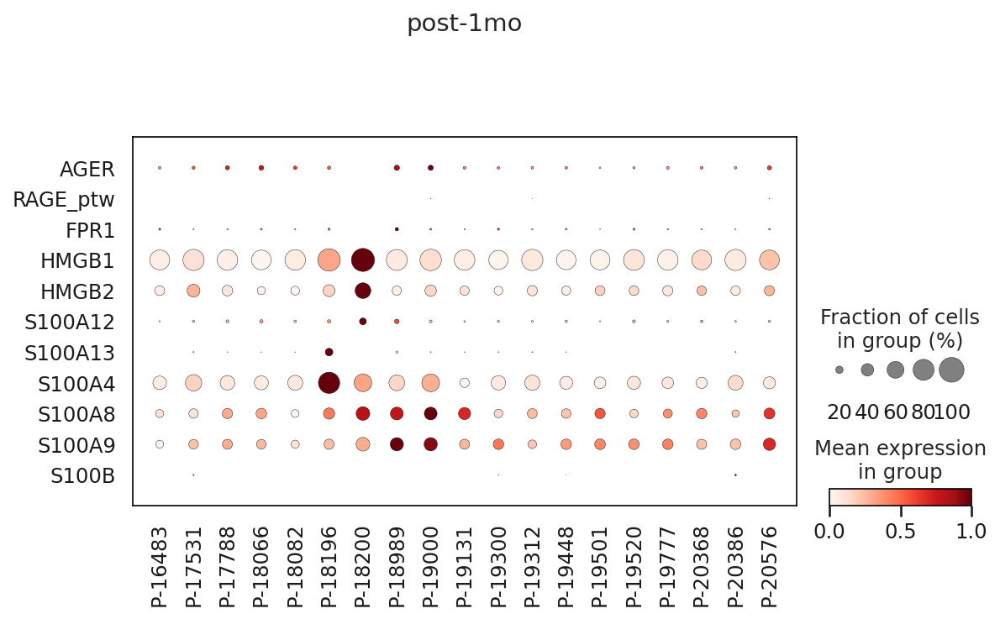

In [185]:
sc.pl.dotplot(adata_sub[(adata_sub.obs.time == "post-1mo")], var_names=["AGER", "RAGE_ptw"] + rage_pathway_genes,
              groupby='patient', use_raw=True, expression_cutoff=0, swap_axes=True, standard_scale="var", title="post-1mo")

## RAGE pathway average score

In [186]:
patient_metadata = ["severity_coarse", "patient", "time", "severity_time", "oxygen", "age", 'mildness_time', 'mildness']

In [187]:
patient_mean = adata_sub.obs[patient_metadata + ["RAGE_ptw"]].groupby(by=patient_metadata, observed=True, dropna=True).mean()
patient_mean.reset_index(inplace=True)

for i in patient_mean.columns:
    try:
        patient_mean[i] = patient_mean[i].cat.remove_unused_categories()
    except AttributeError:
        pass
    
patient_mean

,severity_coarse,patient,time,severity_time,oxygen,age,mildness_time,mildness,RAGE_ptw
0,mild,P-19501,discharge,mild_discharge,0.0,48.0,mild_discharge,mild,-6.363190
1,mild,P-19501,admission,mild_admission,0.0,48.0,mild_admission,mild,-3.439415
2,mild,P-19501,post-1mo,mild_post-1mo,0.0,48.0,mild_post-1mo,mild,-3.660045
3,mild,P-20368,discharge,mild_discharge,0.0,30.0,mild_discharge,mild,-6.441449
4,mild,P-20368,admission,mild_admission,0.0,30.0,mild_admission,mild,-3.413962
5,mild,P-20368,post-1mo,mild_post-1mo,0.0,30.0,mild_post-1mo,mild,-4.398159
6,mild,P-18989,discharge,mild_discharge,0.0,61.0,mild_discharge,mild,-3.451867
7,mild,P-18989,admission,mild_admission,0.0,61.0,mild_admission,mild,-3.567733
8,mild,P-18989,post-1mo,mild_post-1mo,0.0,61.0,mild_post-1mo,mild,-4.728025
9,mild,P-19300,discharge,mild_discharge,0.0,55.0,mild_discharge,mild,-5.806667


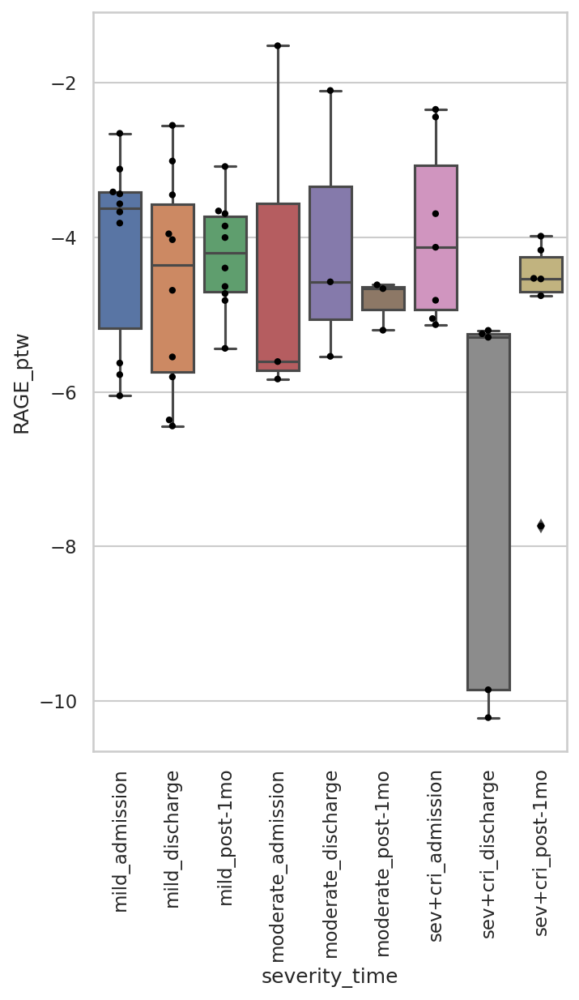

In [188]:
sns.set(rc={'figure.figsize':(5, 8)})
sns.set_style("whitegrid")
ax = sns.boxplot(y="RAGE_ptw", x="severity_time", data=patient_mean)
ax2 = sns.swarmplot(y="RAGE_ptw", x="severity_time", data=patient_mean, size=4, color="black")
lab = ax.set_xticklabels(ax.get_xticklabels(), rotation=90)

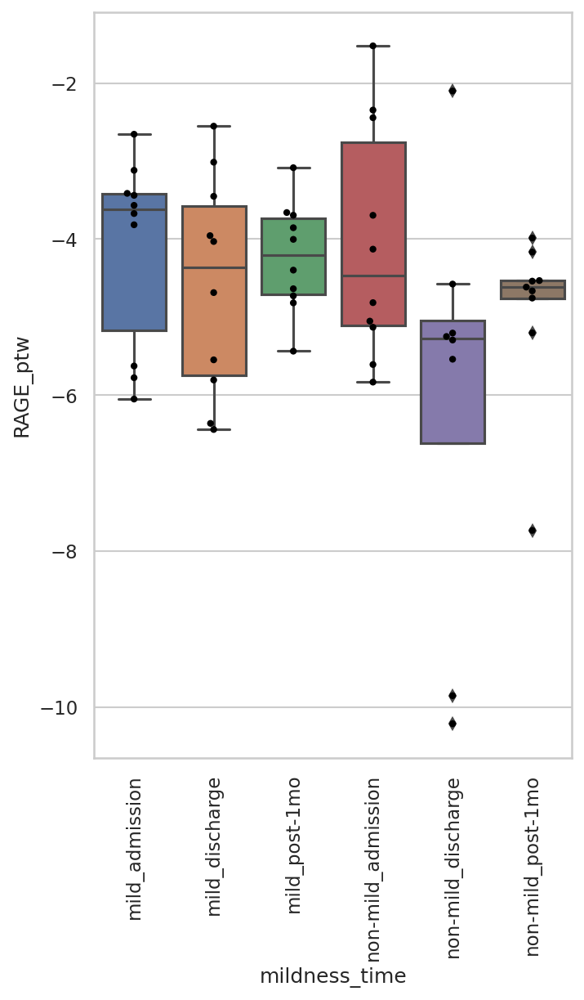

In [189]:
sns.set(rc={'figure.figsize':(5, 8)})
sns.set_style("whitegrid")
ax = sns.boxplot(y="RAGE_ptw", x="mildness_time", data=patient_mean)
ax2 = sns.swarmplot(y="RAGE_ptw", x="mildness_time", data=patient_mean, size=4, color="black")
lab = ax.set_xticklabels(ax.get_xticklabels(), rotation=90)